# (一) Initial

In [ ]:
import pandas as pd
print(pd.__version__)

2.2.1


In [71]:
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google.colab'

In [ ]:
!pip install leafmap
!pip install pandas
!pip install xarray rioxarray netcdf4 localtileserver
!pip install xarray
!pip install ipyleaflet
!pip install folium
!pip install matplotlib
!pip install cartopy
!pip install netcdf4
!pip install cartopy
!pip install xgboost
!pip install geopandas
!pip install xgboost

In [ ]:
!pip install --upgrade numexpr --user

In [ ]:
pip install --upgrade bottleneck --user

Note: you may need to restart the kernel to use updated packages.


# (二) 國海院Data analysis

In [ ]:
conda update scipy

^C

Note: you may need to restart the kernel to use updated packages.


In [ ]:
pip install numpy==1.22.0 --user

In [ ]:
pip install pandas==1.5.3 --user

Note: you may need to restart the kernel to use updated packages.


In [ ]:
conda list numpy

# packages in environment at C:\Users\diclab\anaconda3:
#
# Name                    Version                   Build  Channel
numpy                     1.22.0                   pypi_0    pypi
numpydoc                  1.2                pyhd3eb1b0_0  

Note: you may need to restart the kernel to use updated packages.


In [ ]:
pip install xarray==0.18.0 --user

Note: you may need to restart the kernel to use updated packages.


In [1]:
import pandas as pd
import leafmap.foliumap as leafmap

# 加载两个CSV文件
file_path_stations = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv'
file_path_chlorophyll = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/測站資料葉綠素.csv'

# 读取CSV文件
df_stations = pd.read_csv(file_path_stations)
df_chlorophyll = pd.read_csv(file_path_chlorophyll)
# 移除所有 "核四预定地外海" 的记录
df_chlorophyll = df_chlorophyll[df_chlorophyll['測站'] != '核四預定地外海']
df_chlorophyll = df_chlorophyll.dropna(subset=['測站'])


# 创建地图
m = leafmap.Map(layers_control=True, basemap='OpenStreetMap')
m.add_basemap('CartoDB.Positron')


# 为每个监测站添加标记
for index, row in df_stations.iterrows():
    # 提取经纬度和监测站名称
    lon, lat = row['LON'], row['LAT']
    name = row['STATION_NAME'] + "(" + str(row['STATION_ID']) + ")"  # 确保STATION_ID是字符串

    # 在地图上添加标记
    m.add_marker(location=[lat, lon], popup=name)


# 创建一个从STATION_NAME到经纬度的映射
station_location_map = {row['STATION_NAME']: (row['LON'], row['LAT']) for index, row in df_stations.iterrows()}

# 遍历葉綠素濃度数据，为每个测试站查找对应的经纬度
for index, row in df_chlorophyll.iterrows():
    station_name = row['測站']

    # 查找对应的经纬度
    if station_name in station_location_map:
        lon, lat = station_location_map[station_name]
        # 打印或处理经纬度数据
        # print(f"Station: {station_name}, Longitude: {lon}, Latitude: {lat}")
    else:
        print(f"Station: {station_name} not found in location data.")


print("總共測站站點:", len(df_stations))
# 显示地图
m

總共測站站點: 127


In [ ]:
import pandas as pd
import leafmap.foliumap as leafmap

# 加载两个CSV文件
file_path_stations = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv'
file_path_chlorophyll = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/測站資料葉綠素new.csv'

# 读取CSV文件
df_stations = pd.read_csv(file_path_stations)
df_chlorophyll = pd.read_csv(file_path_chlorophyll)
# 移除所有 "核四预定地外海" 的记录
df_chlorophyll = df_chlorophyll[df_chlorophyll['測站'] != '核四預定地外海']
df_chlorophyll = df_chlorophyll.dropna(subset=['測站'])


# 创建一个从STATION_NAME到经纬度的映射
station_location_map = {row['STATION_NAME']: (row['LON'], row['LAT']) for index, row in df_stations.iterrows()}

# 遍历葉綠素濃度数据，为每个测试站查找对应的经纬度
for index, row in df_chlorophyll.iterrows():
    station_name = row['測站']

    # 查找对应的经纬度
    if station_name in station_location_map:
        lon, lat = station_location_map[station_name]
        # 打印或处理经纬度数据
        # print(f"Station: {station_name}, Longitude: {lon}, Latitude: {lat}")
    else:
        print(f"Station: {station_name} not found in location data.")

In [ ]:
# 确保日期列是日期格式
df_chlorophyll['採樣日期'] = pd.to_datetime(df_chlorophyll['採樣日期'], format='%m/%d/%Y')

# 筛选出特定日期的数据
specific_date = '2022-03-17'
filtered_data = df_chlorophyll[df_chlorophyll['採樣日期'] == specific_date]

# 显示结果
print(filtered_data)

             測站       採樣日期 葉綠素a (μg/L)
2066       大安溪口 2022-03-17           4
2067     臺中港沿海一 2022-03-17         0.9
2068     臺中港沿海二 2022-03-17         0.2
2069       大肚溪口 2022-03-17         1.3
2070   大肚溪口外4海浬 2022-03-17         1.1
2071      和平溪河口 2022-03-17         0.2
2072  和平溪口外4海浬處 2022-03-17        <0.1
2073        和平港 2022-03-17         0.1
2074      立霧溪河口 2022-03-17         0.2
2075       馬祖海峽 2022-03-17        13.7
2076     北竿東部沿海 2022-03-17           9
2077     東引北部沿海 2022-03-17         0.2
2078        龜山島 2022-03-17         2.6
2079      得子口溪口 2022-03-17         2.1
2080       蘭陽溪口 2022-03-17         2.2
2081       新城溪口 2022-03-17         1.5
2082        蘇澳港 2022-03-17         0.3
2083       基隆港一 2022-03-17         2.5
2084       基隆港二 2022-03-17         3.1
2085     基隆拋泥區一 2022-03-17         3.6
2086     八斗子垃圾場 2022-03-17         3.5
2087        和平島 2022-03-17         2.3
2088  員山子分洪道出海口 2022-03-17         3.2


In [ ]:
import pandas as pd
import leafmap.foliumap as leafmap

# 加载两个CSV文件
file_path_stations = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv'
file_path_chlorophyll = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/測站資料葉綠素new.csv'

# 读取CSV文件
df_stations = pd.read_csv(file_path_stations)
df_chlorophyll = pd.read_csv(file_path_chlorophyll)

# 移除所有 "核四预定地外海" 的记录
df_chlorophyll = df_chlorophyll[df_chlorophyll['測站'] != '核四預定地外海']
df_chlorophyll = df_chlorophyll.dropna(subset=['測站'])

# 确保日期列是日期格式
df_chlorophyll['採樣日期'] = pd.to_datetime(df_chlorophyll['採樣日期'], format='%m/%d/%Y')
# 筛选出特定日期的数据
specific_date = '2022-03-17'
filtered_data = df_chlorophyll[df_chlorophyll['採樣日期'] == specific_date]

# 创建一个从STATION_NAME到经纬度的映射
station_location_map = {row['STATION_NAME']: (row['LON'], row['LAT']) for index, row in df_stations.iterrows()}

# 遍历葉綠素濃度数据，为每个测试站查找对应的经纬度
for index, row in filtered_data.iterrows():
    station_name = row['測站']
    chlorophyll_data = row['葉綠素a (μg/L)']

    # 查找对应的经纬度
    if station_name in station_location_map:
        lon, lat = station_location_map[station_name]
        # 打印或处理经纬度数据
        print(f"Station: {station_name}, Longitude: {lon}, Latitude: {lat}, 葉綠素a (μg/L): {chlorophyll_data}" )
    else:
        print(f"Station: {station_name} not found in location data.")

# 显示结果
# print(filtered_data)

Station: 大安溪口, Longitude: 120.585687, Latitude: 24.411452, 葉綠素a (μg/L): 4
Station: 臺中港沿海一, Longitude: 120.491169, Latitude: 24.310037, 葉綠素a (μg/L): 0.9
Station: 臺中港沿海二, Longitude: 120.456334, Latitude: 24.334846, 葉綠素a (μg/L): 0.2
Station: 大肚溪口, Longitude: 120.478358, Latitude: 24.202987, 葉綠素a (μg/L): 1.3
Station: 大肚溪口外4海浬, Longitude: 120.42518, Latitude: 24.20855, 葉綠素a (μg/L): 1.1
Station: 和平溪河口, Longitude: 121.786608, Latitude: 24.315765, 葉綠素a (μg/L): 0.2
Station: 和平溪口外4海浬處, Longitude: 121.833917, Latitude: 24.298113, 葉綠素a (μg/L): <0.1
Station: 和平港, Longitude: 121.776009, Latitude: 24.300055, 葉綠素a (μg/L): 0.1
Station: 立霧溪河口, Longitude: 121.669926, Latitude: 24.13874, 葉綠素a (μg/L): 0.2
Station: 馬祖海峽, Longitude: 119.94976, Latitude: 26.194569, 葉綠素a (μg/L): 13.7
Station: 北竿東部沿海, Longitude: 120.018425, Latitude: 26.236458, 葉綠素a (μg/L): 9
Station: 東引北部沿海, Longitude: 120.4794351, Latitude: 26.3951018, 葉綠素a (μg/L): 0.2
Station: 龜山島, Longitude: 121.943413, Latitude: 24.828021, 葉綠素a (μg/L): 2.6

# (三) 向日葵衛星

#### 資料解析

In [ ]:
import os

# 指定你Google Drive中的資料夾路徑
folder_path = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/L3/CHL/'

# 列出資料夾中的檔案
files = os.listdir(folder_path)

# 顯示檔案清單
for file in files:
    print(file)
#     if (file=="H08_20220317_0000_1D_ROC021_FLDK.02401_02401.nc"):
#       filename = file
#     elif (file=="H08_20220317_0000_1D_rOC021_FLDK.02401_02401.nc")
#       filename2 = file    

H09_20231213_0000_1H_rOC021_FLDK.02701_02601.nc
H09_20231213_0000_1H_ROC021_FLDK.02401_02401.nc
H09_20231212_0000_1D_rOC021_FLDK.02701_02601.nc
H09_20231212_0000_1D_ROC021_FLDK.02401_02401.nc
H08_20220317_0000_1D_ROC021_FLDK.02401_02401.nc
H08_20220317_0000_1D_rOC021_FLDK.02701_02601.nc
2016
2017
2018
2019
2020
2021
2022
2023


In [ ]:
import leafmap.foliumap as leafmap

filename = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/L3/CHL/H08_20220317_0000_1D_ROC021_FLDK.02401_02401.nc'
filename2 =  'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/L3/CHL/H08_20220317_0000_1D_rOC021_FLDK.02701_02601.nc'
fileweather = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/clavrx_H09_20240222_0400_B01_FLDK_DK_R10_S0110.DAT_NAMR.level2.nc'

In [ ]:
data = leafmap.read_netcdf(fileweather) #clavrx_H09_20240222_0400_B01_FLDK_DK_R10_S0110.DAT_NAMR.level2.nc
data

<xarray.Dataset>
Dimensions:                            (pixel_elements_along_scan_direction: 1532, scan_lines_along_track_direction: 1431)
Coordinates:
    latitude                           (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
    longitude                          (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
Dimensions without coordinates: pixel_elements_along_scan_direction, scan_lines_along_track_direction
Data variables: (12/39)
    latitude_pc                        (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
    longitude_pc                       (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
    bad_scan_line_flag                 (scan_lines_along_track_direction) float32 ...
    scan_line_number                   (scan_lines_along_track_direction) int32 ...
    scan_line_time                     (scan_lines_along_track_direction) timedelta64[ns] ...
    bad_pixel_mask                     (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
    ...                                 ...
    refl_0_65um_nom_max_sub            (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
    refl_0_65um_nom_clear_sky          (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
    refl_0_86um_nom                    (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
    refl_0_86um_nom_min_sub            (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
    refl_0_86um_nom_max_sub            (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
    refl_0_86um_nom_clear_sky          (scan_lines_along_track_direction, pixel_elements_along_scan_direction) float32 ...
Attributes: (12/93)
    HDF_LIB_VERSION:                      HDF Version 4.2 Release 13, June 24...
    HDF5_lib_version:                     1.8.20
    netCDF_lib_version:                   4.7.1 of Feb 16 2021 21:28:22 $
    MACHINE:                              moon-sst.cwa.gov.tw
    PROGLANG:                             F90
    date_created:                         2024-02-23T00:53:14+00:00
    ...                                   ...
    NUMBER_OF_SCANS_LEVEL1B:              1431
    NUMBER_OF_SCANS_LEVEL2:               1431
    PROCESSING_TIME_MINUTES:              3.0788834
    NONCONFIDENT_CLOUD_MASK_FRACTION:     0.08555737
    ACHA_SUCCESS_FRACTION:                0.99319845
    DCOMP_SUCCESS_FRACTION:               0.99496204

In [ ]:
data = leafmap.read_netcdf(filename) #H08_20220317_0000_1D_ROC021_FLDK.02401_02401.nc
data

<xarray.Dataset>
Dimensions:              (latitude: 2401, longitude: 2401, band: 8, time: 1, geometry: 17)
Coordinates:
  * latitude             (latitude) float32 60.0 59.95 59.9 ... -59.95 -60.0
  * longitude            (longitude) float32 80.0 80.05 80.1 ... 200.0 200.0
Dimensions without coordinates: band, time, geometry
Data variables: (12/13)
    band_id              (band) int32 ...
    start_time           (time) datetime64[ns] ...
    end_time             (time) datetime64[ns] ...
    geometry_parameters  (geometry) float64 ...
    AROT_02              (latitude, longitude) float32 ...
    ARAE                 (latitude, longitude) float32 ...
    ...                   ...
    Rw_02                (latitude, longitude) float32 ...
    Rw_03                (latitude, longitude) float32 ...
    chlor_a              (latitude, longitude) float32 ...
    apg442               (latitude, longitude) float32 ...
    bbp442               (latitude, longitude) float32 ...
    Sample_number        (latitude, longitude) float32 ...
Attributes: (12/13)
    title:                          Himawari-08 AHI equal latitude-longitude ...
    id:                             H08_20220317_0000_1D_ROC021_FLDK.02401_02...
    date_created:                   2023-03-21T09:33:24Z
    pixel_number:                   2401
    line_number:                    2401
    upper_left_latitude:            60.0
    ...                             ...
    grid_interval:                  0.05
    band_number:                    8
    algorithm version:              
    Ancillary meteorological data:  JMA objective analysis
    Ancillary ozone data:           JMA objective analysis
    BRDF correction:                on (Morel and Maritorena 2001)

In [ ]:
data2 = leafmap.read_netcdf(filename2) #H08_20220317_0000_1D_rOC021_FLDK.02701_02601.nc
data2

<xarray.Dataset>
Dimensions:              (latitude: 2601, longitude: 2701, band: 8, time: 1, geometry: 17)
Coordinates:
  * latitude             (latitude) float32 50.0 49.99 49.98 ... 24.01 24.0
  * longitude            (longitude) float32 123.0 123.0 123.0 ... 150.0 150.0
Dimensions without coordinates: band, time, geometry
Data variables: (12/13)
    band_id              (band) int32 ...
    start_time           (time) datetime64[ns] ...
    end_time             (time) datetime64[ns] ...
    geometry_parameters  (geometry) float64 ...
    AROT_02              (latitude, longitude) float32 ...
    ARAE                 (latitude, longitude) float32 ...
    ...                   ...
    Rw_02                (latitude, longitude) float32 ...
    Rw_03                (latitude, longitude) float32 ...
    chlor_a              (latitude, longitude) float32 ...
    apg442               (latitude, longitude) float32 ...
    bbp442               (latitude, longitude) float32 ...
    Sample_number        (latitude, longitude) float32 ...
Attributes: (12/13)
    title:                          Himawari-08 AHI equal latitude-longitude ...
    id:                             H08_20220317_0000_1D_rOC021_FLDK.02701_02...
    date_created:                   2023-03-21T10:13:31Z
    pixel_number:                   2701
    line_number:                    2601
    upper_left_latitude:            50.0
    ...                             ...
    grid_interval:                  0.01
    band_number:                    8
    algorithm version:              
    Ancillary meteorological data:  JMA objective analysis
    Ancillary ozone data:           JMA objective analysis
    BRDF correction:                on (Morel and Maritorena 2001)

#### 資料詳情

##### 1. 葉綠素值範圍

In [ ]:
import pandas as pd

# Load your CSV data into a DataFrame
data = pd.read_csv('G:/My Drive/DIC Desktop/3 grade s1/thesis/updated_compare_v1.csv')

# Convert 'none' to NaN and change the dtype of both columns to float
data['葉綠素a (μg/L)'] = pd.to_numeric(data['葉綠素a (μg/L)'], errors='coerce')
data['葉綠素a NetCDF (μg/L)'] = pd.to_numeric(data['葉綠素a NetCDF (μg/L)'], errors='coerce')

# Calculate the range for '葉綠素a (μg/L)'
chlorophyll_a_range = data['葉綠素a (μg/L)'].max() - data['葉綠素a (μg/L)'].min()

# Calculate the range for '葉綠素a NetCDF (μg/L)'
chlorophyll_a_ncdf_range = data['葉綠素a NetCDF (μg/L)'].max() - data['葉綠素a NetCDF (μg/L)'].min()

# Print the range
print(f"Range for '葉綠素a (μg/L)': {chlorophyll_a_range}")
print(f"Range for 'max': {data['葉綠素a (μg/L)'].max()}")
print(f"Range for 'min': {data['葉綠素a (μg/L)'].min()}")
print(f"Range for '葉綠素a NetCDF (μg/L)': {chlorophyll_a_ncdf_range}")
print(f"Range for 'max': {data['葉綠素a NetCDF (μg/L)'].max()}")
print(f"Range for 'min': {data['葉綠素a NetCDF (μg/L)'].min()}")

Range for '葉綠素a (μg/L)': 56.199999999999996
Range for 'max': 56.3
Range for 'min': 0.1
Range for '葉綠素a NetCDF (μg/L)': 107.88400809999999
Range for 'max': 107.8880081
Range for 'min': 0.004


##### 2. Heatmap

In [ ]:
import xarray as xr
import leafmap

# Load the dataset
ds = xr.open_dataset(filename) #H08_20220317_0000_1D_ROC021_FLDK.02401_02401.nc (5km)
ds_J = xr.open_dataset(filename2) #H08_20220317_0000_1D_rOC021_FLDK.02701_02601.nc (1km Japan)

# Extract the 'chlor_a' data
chlor_a = ds['chlor_a']
chlor_a_J = ds_J['chlor_a']


# 提取 'chlor_a' 變數的單位
if 'units' in ds['chlor_a'].attrs:
    units = ds['chlor_a'].attrs['units']
    print("Units of 'chlor_a':", units, "\n")
else:
    print("No units attribute found for 'chlor_a'.")

# Calculate the maximum and minimum values
max_value = chlor_a.max()
min_value = chlor_a.min()

max_value_J = chlor_a_J.max()
min_value_J = chlor_a_J.min()

print("Full-disk:")
print("Maximum value of chlor_a:", max_value.values, units)
print("Minimum value of chlor_a:", min_value.values, units, "\n")

print("Japan Area:")
print("Maximum value of chlor_a:", max_value_J.values, units)
print("Minimum value of chlor_a:", min_value_J.values, units)

Units of 'chlor_a': mg/m^3 

Full-disk:
Maximum value of chlor_a: 124.45601 mg/m^3
Minimum value of chlor_a: -128.988 mg/m^3 

Japan Area:
Maximum value of chlor_a: 130.804 mg/m^3
Minimum value of chlor_a: -130.75601 mg/m^3


In [ ]:
import xarray as xr
import leafmap
import pandas as pd

# Load the dataset
ds = xr.open_dataset(filename)  #H08_20220317_0000_1D_ROC021_FLDK.02401_02401.nc (5km)

# Select the variable to visualize
variable_to_visualize = 'chlor_a'  # Replace with the desired variable

# Convert the data to a Pandas DataFrame
# df = ds.to_dataframe().reset_index()
df_variable = ds[variable_to_visualize].to_dataframe().reset_index()

# Handle missing values, if any
df = df_variable.dropna(subset=['latitude', 'longitude', variable_to_visualize])

# Create a leafmap Map object
m2 = leafmap.Map(layers_control=True)
m2.add_basemap('CartoDB.Positron')

# Add a heatmap layer
# Adjust radius and intensity as needed
m2.add_heatmap(df, latitude='latitude', longitude='longitude', value=variable_to_visualize, name='Chlorophyll-a Heatmap', radius=20)

m2


Map(center=[20, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_text…

#### 葉綠素 (DAY)

In [ ]:
import xarray as xr
import pandas as pd
import leafmap.foliumap as leafmap

# 加载两个CSV文件
file_path_stations = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv'
file_path_chlorophyll = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/測站資料葉綠素new.csv'

# csv_file_path = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/updated_chlorophyll_data.csv'  

# 读取CSV文件
df_stations = pd.read_csv(file_path_stations)
df_chlorophyll = pd.read_csv(file_path_chlorophyll)

# 移除所有 "核四预定地外海" 的记录
df_chlorophyll = df_chlorophyll[df_chlorophyll['測站'] != '核四預定地外海']
df_chlorophyll = df_chlorophyll.dropna(subset=['測站'])

# 确保日期列是日期格式
df_chlorophyll['採樣日期'] = pd.to_datetime(df_chlorophyll['採樣日期'], format='%m/%d/%Y')
# 筛选出特定日期的数据
specific_date = '2022-03-17'
filtered_data = df_chlorophyll[df_chlorophyll['採樣日期'] == specific_date]


filename = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/L3/CHL/H08_20220317_0000_1D_ROC021_FLDK.02401_02401.nc'
# 加载NetCDF文件
ds = xr.open_dataset(filename)  #H08_20220317_0000_1D_ROC021_FLDK.02401_02401.nc (5km)

# 初始化一个列表来存储NetCDF中提取的葉綠素濃度值
chlor_a_netCDF_values = []

# 对每个测试站获取葉綠素濃度值
for index, row in filtered_data.iterrows():
    station_name = row['測站']
    chlorophyll_data = row['葉綠素a (μg/L)']

    # 查找对应的经纬度
    if station_name in station_location_map:
        lon, lat = station_location_map[station_name]

        # 在NetCDF数据集中查找最接近的葉綠素濃度值
        chlor_a_value = ds['chlor_a'].sel(longitude=lon, latitude=lat, method='nearest').values
        
        # 将葉綠素濃度值存储在新列中
#         filtered_data.at[index, '葉綠素a NetCDF (μg/L)'] = chlor_a_value.item()  # 使用 .item() 将 numpy 值转换为 Python 标量
        chlor_a_netCDF_values.append(chlor_a_value.item())  # 将提取的值添加到列表中
#         filtered_data.to_csv('G:/My Drive/DIC Desktop/3 grade s1/thesis/updated_chlorophyll_data.csv', index=False)
        
        print(f"Station: {station_name}, Longitude: {lon}, Latitude: {lat}, 葉綠素a CSV (μg/L): {chlorophyll_data}, 葉綠素a NetCDF (μg/L): {chlor_a_value}")
    else:
        # 如果找不到匹配的站点，添加一个NaN值
        chlor_a_netCDF_values.append(pd.NA)
        print(f"Station: {station_name} not found in location data.")
        
# 将提取的葉綠素濃度值添加到DataFrame中
filtered_data['葉綠素a NetCDF (μg/L)'] = chlor_a_netCDF_values
filtered_data.to_csv('G:/My Drive/DIC Desktop/3 grade s1/thesis/updated_chlorophyll_data.csv', index=False)
        



Station: 大安溪口, Longitude: 120.585687, Latitude: 24.411452, 葉綠素a CSV (μg/L): 4, 葉綠素a NetCDF (μg/L): nan
Station: 臺中港沿海一, Longitude: 120.491169, Latitude: 24.310037, 葉綠素a CSV (μg/L): 0.9, 葉綠素a NetCDF (μg/L): nan
Station: 臺中港沿海二, Longitude: 120.456334, Latitude: 24.334846, 葉綠素a CSV (μg/L): 0.2, 葉綠素a NetCDF (μg/L): 0.8640000224113464
Station: 大肚溪口, Longitude: 120.478358, Latitude: 24.202987, 葉綠素a CSV (μg/L): 1.3, 葉綠素a NetCDF (μg/L): nan
Station: 大肚溪口外4海浬, Longitude: 120.42518, Latitude: 24.20855, 葉綠素a CSV (μg/L): 1.1, 葉綠素a NetCDF (μg/L): 12.000000953674316
Station: 和平溪河口, Longitude: 121.786608, Latitude: 24.315765, 葉綠素a CSV (μg/L): 0.2, 葉綠素a NetCDF (μg/L): nan
Station: 和平溪口外4海浬處, Longitude: 121.833917, Latitude: 24.298113, 葉綠素a CSV (μg/L): <0.1, 葉綠素a NetCDF (μg/L): nan
Station: 和平港, Longitude: 121.776009, Latitude: 24.300055, 葉綠素a CSV (μg/L): 0.1, 葉綠素a NetCDF (μg/L): nan
Station: 立霧溪河口, Longitude: 121.669926, Latitude: 24.13874, 葉綠素a CSV (μg/L): 0.2, 葉綠素a NetCDF (μg/L): nan
Station: 馬祖海峽, 

In [ ]:
import xarray as xr
import pandas as pd
import leafmap.foliumap as leafmap

year = 2022
month = '03'
date = '18'

# 加载两个CSV文件
file_path_stations = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv'
file_path_chlorophyll = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/測站資料葉綠素new.csv'
filename = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/L3/CHL/{year}/{month}/H08_{year}{month}{date}_0000_1D_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date)

# csv_file_path = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/updated_chlorophyll_data.csv'  

# 读取CSV文件
df_stations = pd.read_csv(file_path_stations)
df_chlorophyll = pd.read_csv(file_path_chlorophyll)

# 移除所有 "核四预定地外海" 的记录
df_chlorophyll = df_chlorophyll[df_chlorophyll['測站'] != '核四預定地外海']
df_chlorophyll = df_chlorophyll.dropna(subset=['測站'])

# 确保日期列是日期格式
df_chlorophyll['採樣日期'] = pd.to_datetime(df_chlorophyll['採樣日期'], format='%m/%d/%Y')

# 筛选出特定日期的数据
date_string = '{}-{}-{}'.format(year, month, date)
# specific_date = pd.to_datetime(date_string)
specific_date = pd.to_datetime('2022-03-17')


# 创建站点名称到经纬度的映射
station_location_map = {row['STATION_NAME']: (row['LON'], row['LAT']) for index, row in df_stations.iterrows()}

# 加载NetCDF文件
ds = xr.open_dataset(filename)

# 在df_chlorophyll中添加一个新列，用于存储NetCDF中的葉綠素濃度值
df_chlorophyll['葉綠素a NetCDF (μg/L)'] = pd.NA

# 初始化一个列表来存储 NetCDF 中的葉綠素濃度值
# chlor_a_netCDF_values = []

# 保存更新后的DataFrame到CSV文件，确保使用UTF-8编码
output_csv_file_path = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/updated_chlorophyll_data.csv'

# 遍历df_chlorophyll中的每一行，提取NetCDF文件中相对应的葉綠素濃度值
for index, row in df_chlorophyll.iterrows():
    # 只处理特定日期的数据
    if row['採樣日期'] == specific_date:
        print(specific_date)
        station_name = row['測站']
        chlorophyll_data = row['葉綠素a (μg/L)']

        if station_name in station_location_map:
            lon, lat = station_location_map[station_name]
            try:
                # 提取最接近的葉綠素濃度值
                chlor_a_value = ds['chlor_a'].sel(longitude=lon, latitude=lat, method='nearest').values
                # 将值赋给新列
                df_chlorophyll.at[index, '葉綠素a NetCDF (μg/L)'] = chlor_a_value.item()
#                 a.to_csv(output_csv_file_path, index=False, encoding='utf-8')
                print(f"Station: {station_name}, Longitude: {lon}, Latitude: {lat}, 葉綠素a CSV (μg/L): {chlorophyll_data}, 葉綠素a NetCDF (μg/L): {chlor_a_value}")
            except KeyError:
                continue  # 如果在NetCDF文件中没有找到数据，则跳过

# 保存更新后的DataFrame到CSV文件，确保使用UTF-8编码
output_csv_file_path = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/updated_chlorophyll_data.csv'
df_chlorophyll.to_csv(output_csv_file_path, index=False, encoding='utf-8')

2022-03-17 00:00:00
Station: 大安溪口, Longitude: 120.585687, Latitude: 24.411452, 葉綠素a CSV (μg/L): 4, 葉綠素a NetCDF (μg/L): nan
2022-03-17 00:00:00
Station: 臺中港沿海一, Longitude: 120.491169, Latitude: 24.310037, 葉綠素a CSV (μg/L): 0.9, 葉綠素a NetCDF (μg/L): 3.892000198364258
2022-03-17 00:00:00
Station: 臺中港沿海二, Longitude: 120.456334, Latitude: 24.334846, 葉綠素a CSV (μg/L): 0.2, 葉綠素a NetCDF (μg/L): 1.724000096321106
2022-03-17 00:00:00
Station: 大肚溪口, Longitude: 120.478358, Latitude: 24.202987, 葉綠素a CSV (μg/L): 1.3, 葉綠素a NetCDF (μg/L): nan
2022-03-17 00:00:00
Station: 大肚溪口外4海浬, Longitude: 120.42518, Latitude: 24.20855, 葉綠素a CSV (μg/L): 1.1, 葉綠素a NetCDF (μg/L): 5.692000389099121
2022-03-17 00:00:00
Station: 和平溪河口, Longitude: 121.786608, Latitude: 24.315765, 葉綠素a CSV (μg/L): 0.2, 葉綠素a NetCDF (μg/L): 0.796000063419342
2022-03-17 00:00:00
Station: 和平溪口外4海浬處, Longitude: 121.833917, Latitude: 24.298113, 葉綠素a CSV (μg/L): <0.1, 葉綠素a NetCDF (μg/L): 0.3320000171661377
2022-03-17 00:00:00
Station: 和平港, Longitude

In [ ]:
import xarray as xr
import pandas as pd
import numpy as np

year = 2021
month = '08'
date = '20'

# 加载两个CSV文件
file_path_stations = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv'
file_path_chlorophyll = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/updated_chlorophyll_data.csv'
filename = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/L3/CHL/{year}/{month}/H08_{year}{month}{date}_0000_1D_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date)
# filename = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/L3/CHL/{year}/{month}/H09_{year}{month}{date}_0000_1D_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date)

# 读取CSV文件
df_stations = pd.read_csv(file_path_stations)
df_chlorophyll = pd.read_csv(file_path_chlorophyll)

# 移除所有 "核四预定地外海" 的记录
df_chlorophyll = df_chlorophyll[df_chlorophyll['測站'] != '核四預定地外海']
df_chlorophyll = df_chlorophyll.dropna(subset=['測站'])

# 确保日期列是日期格式
# df_chlorophyll['採樣日期'] = pd.to_datetime(df_chlorophyll['採樣日期'], format='%d/%m/%Y')
df_chlorophyll['採樣日期'] = pd.to_datetime(df_chlorophyll['採樣日期'], format='%Y-%m-%d')

# 筛选出特定日期的数据
date_string = '{}-{}-{}'.format(year, month, date)
specific_date = pd.to_datetime(date_string)

# 创建站点名称到经纬度的映射
station_location_map = {row['STATION_NAME']: (row['LON'], row['LAT']) for index, row in df_stations.iterrows()}

# 加载NetCDF文件
ds = xr.open_dataset(filename)

# 初始化一个新的列表来存储NetCDF中的葉綠素濃度值
chlor_a_netCDF_values = []

# 遍历df_chlorophyll中的每一行，提取NetCDF文件中相对应的葉綠素濃度值
for index, row in df_chlorophyll.iterrows():
    # 只处理特定日期的数据
    if row['採樣日期'] == specific_date:
        station_name = row['測站']
        chlorophyll_data = row['葉綠素a (μg/L)']
        
        if station_name in station_location_map:
            lon, lat = station_location_map[station_name]
            try:
                # 提取最接近的葉綠素濃度值
                chlor_a_value = ds['chlor_a'].sel(longitude=lon, latitude=lat, method='nearest').values
                if not np.isnan(chlor_a_value):
                    chlor_a_netCDF_values.append(chlor_a_value.item())  # 将提取的值添加到列表中
                else:
                    chlor_a_netCDF_values.append('none')
                print(f"Station: {station_name}, Longitude: {lon}, Latitude: {lat}, 葉綠素a CSV (μg/L): {chlorophyll_data}, 葉綠素a NetCDF (μg/L): {chlor_a_value}")
            except KeyError:
                continue
#                 chlor_a_netCDF_values.append(pd.NA)
        else:
#             chlor_a_netCDF_values.append(pd.NA)
            continue
    else:
        # 对于其他日期，保留原始值
        chlor_a_netCDF_values.append(row[3])

# 将提取的葉綠素濃度值添加到DataFrame中
df_chlorophyll['葉綠素a NetCDF (μg/L)'] = chlor_a_netCDF_values

# 保存更新后的DataFrame到CSV文件，确保使用UTF-8编码
output_csv_file_path = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/updated_chlorophyll_data.csv'
df_chlorophyll.to_csv(output_csv_file_path, index=False, encoding='utf-8')


Station: 淡水河口外4海浬處, Longitude: 121.370855, Latitude: 25.207526, 葉綠素a CSV (μg/L): 3.4, 葉綠素a NetCDF (μg/L): 3.0920002460479736
Station: 林口發電廠, Longitude: 121.300885, Latitude: 25.127983, 葉綠素a CSV (μg/L): 2.9, 葉綠素a NetCDF (μg/L): 2.7680001258850098
Station: 海湖電廠, Longitude: 121.257305, Latitude: 25.1255, 葉綠素a CSV (μg/L): 3, 葉綠素a NetCDF (μg/L): 4.36400032043457
Station: 新南崁溪口, Longitude: 121.245769, Latitude: 25.12237, 葉綠素a CSV (μg/L): 5.9, 葉綠素a NetCDF (μg/L): nan
Station: 沙崙中油卸油設施一, Longitude: 121.197207, Latitude: 25.12133, 葉綠素a CSV (μg/L): 1.4, 葉綠素a NetCDF (μg/L): nan
Station: 沙崙中油卸油設施二, Longitude: 121.219458, Latitude: 25.130409, 葉綠素a CSV (μg/L): 1.8, 葉綠素a NetCDF (μg/L): 2.4720001220703125
Station: 觀音溪口, Longitude: 121.064251, Latitude: 25.056026, 葉綠素a CSV (μg/L): 1.8, 葉綠素a NetCDF (μg/L): nan
Station: 八里污水廠外海一, Longitude: 121.363775, Latitude: 25.222152, 葉綠素a CSV (μg/L): 2.3, 葉綠素a NetCDF (μg/L): 3.0920002460479736
Station: 八里污水廠外海二, Longitude: 121.40077, Latitude: 25.222617, 葉綠素a CSV (

#### 時間換算

In [88]:
# 定義一個函數來調整時間
df = pd.read_csv('D:/temp/processed_file.csv')  # Load the CSV file
def adjust_time(row):
    if row['PERIOD'] == '下午':
        hour, minute, second = map(int, row['TIME'].split(':'))
        # 只有當小時數小於12時才加12
        if hour < 12:
            hour += 12
        return f'{hour:02d}:{minute:02d}:{second:02d}'
    elif row['PERIOD'] == '上午':
        hour, minute, second = map(int, row['TIME'].split(':'))
        if(hour == 12):
            hour = 0
        return f'{hour:02d}:{minute:02d}:{second:02d}'
    else:
        return row['TIME']

# 應用函數到每一行
df['TIME'] = df.apply(adjust_time, axis=1)

# 存儲為新的CSV檔案
df.to_csv('D:/temp/processed_file_updated.csv', index=False)

#### FTP 下載

In [ ]:
from ftplib import FTP
import os
import pandas as pd
from datetime import datetime

def download_file(filename, save_directory):
    with open(os.path.join(save_directory, filename), "wb") as file:  
        ftp.retrbinary(f"RETR {filename}", file.write)  # download file

def download_entire_directory(directory_name):
    save_directory = os.path.join(download_root, directory_name)
    
    if not os.path.exists(save_directory):
        os.makedirs(save_directory)

    ftp.cwd(directory_name)

    files = ftp.nlst()
    for file in sorted(files):
        download_file(file, save_directory)

    ftp.cwd('../')

def upload_file(filename):
    with open(filename, "rb") as file:
        ftp.storbinary(f"STOR {filename}", file)  # the file you wish to upload in the same directory as this Python code.

def main(user, passwd, ftp):
    
    ftp.login(user, passwd) # login with username and password
    current_directory = ftp.pwd()
        
    # 读取CSV文件
    df = pd.read_csv('G:/My Drive/DIC Desktop/3 grade s1/thesis/new_file.csv')
    
    # 遍历每一行
    for index, row in df.iterrows():
        # 提取日期和时间
        sample_date = row['SAMPLE_DATE']
        time = row['TIME']
        
        # 拆分日期为年、月和日
        month, date, year = map(int, sample_date.split('/'))
        if(date < 10):
            date = '0' + str(date)
        if(month < 10):
            month = '0' + str(month)
        
        # 初始化小时和分钟
        hour, min = None, None
        
        # 如果时间包含冒号，则拆分时间
        if ':' in time:
            time_parts = time.split(':')
            if len(time_parts) >= 2:
                hour, min = map(int, time_parts[:2])
                
        # 确保分钟是10的倍数
        if min is not None:
            min = (min // 10) * 10  # Round down to the nearest 10
        if (min == 0 or min == '0'):
            min ='00'
        if (hour  < 10):
            hour = '0' + str(hour)
        
        # Ensure that minutes are rounded to the nearest whole hour
#         if min is not None:
#             # If minutes are 30 or above, increment the hour, otherwise keep it the same
#             hour = hour + 1 if min >= 30 else hour
#             min = '00'  # Set minutes to '00'

#         # Ensure hour is formatted as a two-digit number
#         if hour < 10:
#             hour = '0' + str(hour)
                
#         print(month, date, year, hour, min)

        # 檢查日期和時間是否晚於 "03 11 2021 07 50"
        current_datetime = datetime(year, int(month), int(date), int(hour), int(min))
        
        if current_datetime >= datetime(2023, 1, 1, 7, 50):
#             print(month, date, year, hour, min)
    #         download_root = "G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/jma/netcdf/{year}/{month}".format(year=year, month=month)  # 這裡請替換成您希望保存檔案的路徑
    #         download_root = "G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/min/CHL/{year}/{month}".format(year=year, month=month)
            download_root = r"D:\temp\{year}\{month}".format(year=year, month=month)  # 這裡請替換成您希望保存檔案的路徑
    
            if not os.path.exists(download_root):
                os.makedirs(download_root)

            ftp.cwd("jma/netcdf/{year}{month}/{date}/".format(year=year, month=month, date=date))  # change directory
    #         ftp.cwd("/pub/himawari/L3/CHL/021/{year}{month}/{date}/".format(year=year, month=month, date=date))

            # download files
            files = ftp.nlst()
            target_file = 'NC_H08_{year}{month}{date}_{hour}{min}_R21_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
    #         target_file = 'H08_{year}{month}{date}_{hour}{min}_1H_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
    #         target_file2 = 'H08_{year}{month}{date}_{hour}{min}_1H_rOC021_FLDK.02701_02601.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
            
            path = download_root
            for file in sorted(files):
                full_path = os.path.join(path, target_file)
                print(target_file)
                print(full_path)
                if file == target_file and not os.path.exists(full_path):
                    download_file(file, download_root)
                    print(month, date, year, hour, min) 
#                 else:
#                     min = int(min) - 10
#                     target_file = 'NC_H08_{year}{month}{date}_{hour}{min}_R21_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
#                     if target_file in file:
#                         download_file(file, download_root)
#                         print(month, date, year, hour, min) 
    #             if target_file2 in file:
    #                 download_file(file, download_root)

            ftp.cwd(current_directory)
        else:
            continue  # 跳過這一行，繼續下一行

if __name__ == "__main__":
    user = "N76101012_gs.ncku.edu.tw"
    passwd = "SP+wari8"

    ftp = FTP("ftp.ptree.jaxa.jp")
    main(user, passwd, ftp)
    ftp.quit()


NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
NC_H08_20230220_1100_R21_FLDK.02401_02401.nc
D

NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
NC_H08_20230221_1120_R21_FLDK.02401_02401.nc
D

NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
NC_H08_20230222_1310_R21_FLDK.02401_02401.nc
D

NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
NC_H08_20230223_1050_R21_FLDK.02401_02401.nc
D

NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
D:\temp\2023\02\NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
NC_H08_20230224_0910_R21_FLDK.02401_02401.nc
D

NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
NC_H08_20230302_0950_R21_FLDK.02401_02401.nc
D

NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
NC_H08_20230303_0730_R21_FLDK.02401_02401.nc
D

NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
NC_H08_20230307_1040_R21_FLDK.02401_02401.nc
D

NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
NC_H08_20230308_1250_R21_FLDK.02401_02401.nc
D

NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
NC_H08_20230308_1350_R21_FLDK.02401_02401.nc
D

NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
NC_H08_20230309_1500_R21_FLDK.02401_02401.nc
D

NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
NC_H08_20230309_1310_R21_FLDK.02401_02401.nc
D

NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
NC_H08_20230316_0930_R21_FLDK.02401_02401.nc
D

NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
NC_H08_20230320_1020_R21_FLDK.02401_02401.nc
D

NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
NC_H08_20230320_1210_R21_FLDK.02401_02401.nc
D

NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
NC_H08_20230321_0730_R21_FLDK.02401_02401.nc
D

NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
NC_H08_20230321_0940_R21_FLDK.02401_02401.nc
D

NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
NC_H08_20230321_1100_R21_FLDK.02401_02401.nc
D

NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
NC_H08_20230331_1200_R21_FLDK.02401_02401.nc
D

NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
D:\temp\2023\03\NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
NC_H08_20230331_1500_R21_FLDK.02401_02401.nc
D

NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
NC_H08_20230515_1240_R21_FLDK.02401_02401.nc
D

NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
NC_H08_20230515_1250_R21_FLDK.02401_02401.nc
D

NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
NC_H08_20230515_1300_R21_FLDK.02401_02401.nc
D

NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
NC_H08_20230515_1320_R21_FLDK.02401_02401.nc
D

NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
NC_H08_20230515_1310_R21_FLDK.02401_02401.nc
D

NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D

NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
NC_H08_20230515_1440_R21_FLDK.02401_02401.nc
D

NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D:\temp\2023\05\NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
NC_H08_20230515_1340_R21_FLDK.02401_02401.nc
D

KeyboardInterrupt: 

In [ ]:
from ftplib import FTP
import os
import pandas as pd
from datetime import datetime

def download_file(filename, save_directory):
    with open(os.path.join(save_directory, filename), "wb") as file:  
        ftp.retrbinary(f"RETR {filename}", file.write)  # download file

def download_entire_directory(directory_name):
    save_directory = os.path.join(download_root, directory_name)
    
    if not os.path.exists(save_directory):
        os.makedirs(save_directory)

    ftp.cwd(directory_name)

    files = ftp.nlst()
    for file in sorted(files):
        download_file(file, save_directory)

    ftp.cwd('../')

def upload_file(filename):
    with open(filename, "rb") as file:
        ftp.storbinary(f"STOR {filename}", file)  # the file you wish to upload in the same directory as this Python code.

def main(user, passwd, ftp):
    
    ftp.login(user, passwd) # login with username and password
    current_directory = ftp.pwd()
        
    # 读取CSV文件
    df = pd.read_csv('G:/My Drive/DIC Desktop/3 grade s1/thesis/new_file.csv')
    
    # 遍历每一行
    for index, row in df.iterrows():
        # 提取日期和时间
        sample_date = row['SAMPLE_DATE']
        time = row['TIME']
        
        # 拆分日期为年、月和日
        month, date, year = map(int, sample_date.split('/'))
        if(date < 10):
            date = '0' + str(date)
        if(month < 10):
            month = '0' + str(month)
        
        # 初始化小时和分钟
        hour, min = None, None
        
        # 如果时间包含冒号，则拆分时间
        if ':' in time:
            time_parts = time.split(':')
            if len(time_parts) >= 2:
                hour, min = map(int, time_parts[:2])
                
        # 确保分钟是10的倍数
        if min is not None:
            min = (min // 10) * 10  # Round down to the nearest 10
        if (min == 0 or min == '0'):
            min ='00'
        if (hour  < 10):
            hour = '0' + str(hour)

        # 檢查日期和時間是否晚於 "03 11 2021 07 50" 04 02 2018 10 10
        current_datetime = datetime(year, int(month), int(date), int(hour), int(min))
        
        if current_datetime >= datetime(2023, 1, 1, 0, 00):
            download_root = r"D:\2km\{year}\{month}".format(year=year, month=month)  # 這裡請替換成您希望保存檔案的路徑

            if not os.path.exists(download_root):
                os.makedirs(download_root)

            ftp.cwd("jma/netcdf/{year}{month}/{date}/".format(year=year, month=month, date=date))  # change directory

            # download files
            files = ftp.nlst()
            # target_file = 'NC_H08_{year}{month}{date}_{hour}{min}_R21_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
            # target_file = 'NC_H09_{year}{month}{date}_{hour}{min}_R21_FLDK.06001_06001.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
            target_file = 'H08_{year}{month}{date}_{hour}{min}_R21_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
        
            path = download_root
            for file in sorted(files):
                full_path = os.path.join(path, target_file)
    #                 print(target_file)
    #                 print(full_path)
    #                 print(file)
                if file == target_file and not os.path.exists(full_path):
                    download_file(file, download_root)
                    print(month, date, year, hour, min) 
                    
            ftp.cwd(current_directory)
        else:
            continue  # 跳過這一行，繼續下一行

if __name__ == "__main__":
    user = "N76101012_gs.ncku.edu.tw"
    passwd = "SP+wari8"

    ftp = FTP("ftp.ptree.jaxa.jp")
    main(user, passwd, ftp)
    ftp.quit()


02 20 2023 11 00
02 21 2023 11 20
02 22 2023 13 10
02 23 2023 10 50
02 24 2023 09 10
03 02 2023 09 50
03 03 2023 07 30
03 07 2023 10 40
03 08 2023 12 50
03 08 2023 13 50
03 09 2023 15 00
03 09 2023 13 10
03 16 2023 09 30
03 20 2023 10 20
03 20 2023 12 10
03 21 2023 07 30
03 21 2023 09 40
03 21 2023 11 00
03 31 2023 12 00
03 31 2023 15 00
05 15 2023 12 40
05 15 2023 12 50
05 15 2023 13 00
05 15 2023 13 20
05 15 2023 13 10
05 15 2023 13 40
05 15 2023 13 50
05 15 2023 10 30
05 15 2023 10 40
05 15 2023 09 50
05 15 2023 10 20
05 15 2023 09 40
05 15 2023 09 20
05 15 2023 09 10
05 15 2023 09 00
05 15 2023 08 00
05 15 2023 07 00
05 15 2023 06 50
05 15 2023 06 30
05 15 2023 06 00
05 24 2023 08 40
05 24 2023 08 50
05 24 2023 09 20
05 24 2023 09 10
05 24 2023 10 30
05 24 2023 10 50
05 24 2023 11 50
05 24 2023 11 00
05 25 2023 13 30
05 25 2023 14 10
05 25 2023 12 50
05 25 2023 11 00
05 25 2023 11 20
06 02 2023 07 30
06 02 2023 07 50
06 02 2023 08 00
06 02 2023 07 40
06 02 2023 08 10
06 06 2023 10 

#### 寫入向日葵衛星葉綠素

In [113]:
import xarray as xr
import pandas as pd
import numpy as np
from datetime import datetime

# 加载两个CSV文件
file_path_stations = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv'
file_path_chlorophyll = 'D:/temp/processed_file_updated.csv'

# 读取CSV文件
df_chlorophyll = pd.read_csv(file_path_chlorophyll)

# 初始化一个新的列表来存储NetCDF中的葉綠素濃度值
chlor_a_netCDF_values = []
    
# 遍历每一行
for index, row in df_chlorophyll.iterrows():
    # 提取日期和时间
    sample_date = row['SAMPLE_DATE']
    time = str(row['TIME'])

    # 拆分日期为年、月和日
    month, date, year = map(int, sample_date.split('/'))
    if(date < 10):
        date = '0' + str(date)
    if(month < 10):
        month = '0' + str(month)

    # 初始化小时和分钟
    hour, min = 0, 0  # 使用默认值0，以避免None导致的问题

    # 如果时间包含冒号，则拆分时间
    if ':' in time:
        time_parts = time.split(':')
        if len(time_parts) >= 2:
            hour, min = map(int, time_parts[:2])

     # Ensure that minutes are rounded to the nearest whole hour
    if min is not None:
        # If minutes are 30 or above, increment the hour, otherwise keep it the same
        hour = hour + 1 if min >= 30 else hour
        min = '00'  # Set minutes to '00'

    # Ensure hour is formatted as a two-digit number
    if hour < 10:
        hour = '0' + str(hour)

    current_datetime = datetime(year, int(month), int(date), int(hour), int(min))    
    
    # 读取CSV文件
    df_stations = pd.read_csv(file_path_stations)

    # 筛选出特定日期的数据
    date_string = '{}/{}/{}'.format(month, date, year)
    specific_date = pd.to_datetime(date_string)
    time_string = '{}:{}'.format(hour, min)
    specific_time = pd.to_datetime(time_string, format='%H:%M').time()

    if current_datetime == datetime(2020, 3, 13, 0, 0) or current_datetime == datetime(2020, 3, 19, 0, 0) or current_datetime == datetime(2020, 5, 5, 0, 0) or current_datetime == datetime(2020, 5, 14, 0, 0)or current_datetime == datetime(2020, 7, 14, 0, 0)or current_datetime == datetime(2020, 7, 15, 0, 0)or current_datetime == datetime(2020, 11, 18, 0, 0)or current_datetime == datetime(2020, 11, 20, 0, 0):
        target_file = 'D:/dataset/CHL 5km/{year}/{month}/H08_{year}{month}{date}_{hour}{min}_1H_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
    elif current_datetime <= datetime(2023, 2, 1, 0, 0):
        target_file = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/min/CHL/{year}/{month}/H08_{year}{month}{date}_{hour}{min}_1H_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
    elif current_datetime > datetime(2023, 2, 1, 0, 0):
        target_file = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/min/CHL/{year}/{month}/H09_{year}{month}{date}_{hour}{min}_1H_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)


    ds = xr.open_dataset(target_file)
    # 创建站点名称到经纬度的映射
    station_location_map = {row['STATION_ID']: (row['LON'], row['LAT']) for index, row in df_stations.iterrows()}

    station_name = row['STATION_NAME']
    station_id = row['STATION_ID']
    chlorophyll_data = row['CHL_a']

    if station_id in station_location_map:
        lon, lat = station_location_map[station_id]
        try:
        # 提取最接近的葉綠素濃度值
            chlor_a_value = ds['chlor_a'].sel(longitude=lon, latitude=lat, method='nearest').values
            # chlor_a_netCDF_values.append(chlor_a_value.item() if not np.isnan(chlor_a_value) else 'none')
            if not np.isnan(chlor_a_value):
                chlor_a_netCDF_values.append(chlor_a_value.item())  # 将提取的值添加到列表中
                print(f"葉綠素:{chlor_a_netCDF_values}")
            else:
                chlor_a_netCDF_values.append('none')
                print(f"葉綠素:{chlor_a_netCDF_values}")
            print(f"Date:{current_datetime}, Station: {station_name}, Longitude: {lon}, Latitude: {lat}, 葉綠素a CSV (μg/L): {chlorophyll_data}, 葉綠素a NetCDF (μg/L): {chlor_a_value}")
        except KeyError:
#             continue
            chlor_a_netCDF_values.append('none')
    else:
        chlor_a_netCDF_values.append('none')

# After the loop
print("Length of chlor_a_netCDF_values:", len(chlor_a_netCDF_values))
print("Number of rows in df_chlorophyll:", len(df_chlorophyll))


# 将提取的葉綠素濃度值添加到DataFrame中
df_chlorophyll['CHL_a NetCDF (μg/L)'] = chlor_a_netCDF_values

# 保存更新后的DataFrame到CSV文件，确保使用UTF-8编码
output_csv_file_path = 'D:/temp/processed_file3.csv'
df_chlorophyll.to_csv(output_csv_file_path, index=False, encoding='utf-8')

葉綠素:['none']
Date:2016-01-04 11:00:00, Station: 高雄港口外一, Longitude: 120.244741, Latitude: 22.637319, 葉綠素a CSV (μg/L): 0.3, 葉綠素a NetCDF (μg/L): nan
葉綠素:['none', 'none']
Date:2016-01-04 12:00:00, Station: 高雄港口外二, Longitude: 120.244184, Latitude: 22.611874, 葉綠素a CSV (μg/L): 0.2, 葉綠素a NetCDF (μg/L): nan
葉綠素:['none', 'none', 'none']
Date:2016-01-04 12:00:00, Station: 高雄港口外三, Longitude: 120.287041, Latitude: 22.559261, 葉綠素a CSV (μg/L): 0.7, 葉綠素a NetCDF (μg/L): nan
葉綠素:['none', 'none', 'none', 'none']
Date:2016-01-04 12:00:00, Station: 旗津, Longitude: 120.26271, Latitude: 22.587929, 葉綠素a CSV (μg/L): 0.3, 葉綠素a NetCDF (μg/L): nan
葉綠素:['none', 'none', 'none', 'none', 'none']
Date:2016-01-07 12:00:00, Station: 中芸港外, Longitude: 120.39373, Latitude: 22.476117, 葉綠素a CSV (μg/L): 0.6, 葉綠素a NetCDF (μg/L): nan
葉綠素:['none', 'none', 'none', 'none', 'none', 'none']
Date:2016-01-07 11:00:00, Station: 高屏溪出海口, Longitude: 120.422062, Latitude: 22.471587, 葉綠素a CSV (μg/L): 1.3, 葉綠素a NetCDF (μg/L): nan
葉綠素:['none',

In [107]:
import xarray as xr
import pandas as pd
import numpy as np
from datetime import datetime

# Load CSV files
file_path_stations = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv'
file_path_chlorophyll = 'D:/temp/processed_file_updated.csv'

# Read CSV files
df_chlorophyll = pd.read_csv(file_path_chlorophyll)
df_stations = pd.read_csv(file_path_stations)

# Create a mapping from station names to their locations
station_location_map = {row['STATION_ID']: (row['LON'], row['LAT']) for index, row in df_stations.iterrows()}

# Initialize a list to store chlorophyll values from NetCDF
chlor_a_netCDF_values = []

# Iterate through each row
for index, row in df_chlorophyll.iterrows():
    # (existing code for processing date, time, and file paths)
    # ...

    try:
        ds = xr.open_dataset(target_file)
        station_id = row['STATION_ID']

        if station_id in station_location_map:
            lon, lat = station_location_map[station_id]
            chlor_a_value = ds['chlor_a'].sel(longitude=lon, latitude=lat, method='nearest').values
            chlor_a_netCDF_values.append(chlor_a_value.item() if not np.isnan(chlor_a_value) else 'none')
        else:
            chlor_a_netCDF_values.append('none')
        
        ds.close()  # Close the NetCDF file
    except Exception as e:
        chlor_a_netCDF_values.append('error')  # Append 'error' or some placeholder
        print(f"Error processing row {index}: {e}")

# Add the chlorophyll values to the DataFrame
df_chlorophyll['CHL_a NetCDF (μg/L)'] = chlor_a_netCDF_values

# Save the updated DataFrame to a CSV file
output_csv_file_path = 'D:/temp/processed_file3.csv'
df_chlorophyll.to_csv(output_csv_file_path, index=False, encoding='utf-8')


KeyboardInterrupt: 

In [ ]:
import xarray as xr
import pandas as pd
import numpy as np
from datetime import datetime

# 加载两个CSV文件
file_path_stations = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv'
file_path_chlorophyll = 'D:/temp/processed_file_updated.csv'
# filename = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/L3/CHL/{year}/{month}/H08_{year}{month}{date}_0000_1D_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date)
# filename = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/L3/CHL/{year}/{month}/H09_{year}{month}{date}_0000_1D_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date)

# 读取CSV文件
df_chlorophyll = pd.read_csv(file_path_chlorophyll)
    
# 遍历每一行
for index, row in df_chlorophyll.iterrows():
    # 提取日期和时间
    sample_date = row['SAMPLE_DATE']
    time = str(row['TIME'])

    # 拆分日期为年、月和日
    month, date, year = map(int, sample_date.split('/'))
    if(date < 10):
        date = '0' + str(date)
    if(month < 10):
        month = '0' + str(month)

    # 初始化小时和分钟
    hour, min = 0, 0  # 使用默认值0，以避免None导致的问题

    # 如果时间包含冒号，则拆分时间
    if ':' in time:
        time_parts = time.split(':')
        if len(time_parts) >= 2:
            hour, min = map(int, time_parts[:2])

    # 确保分钟是10的倍数
    # if min is not None:
    #     min = (min // 10) * 10  # Round down to the nearest 10
    # if (min == 0 or min == '0'):
    #     min ='00'
    # if (hour  < 10):
    #     hour = '0' + str(hour)

     # Ensure that minutes are rounded to the nearest whole hour
    if min is not None:
        # If minutes are 30 or above, increment the hour, otherwise keep it the same
        hour = hour + 1 if min >= 30 else hour
        min = '00'  # Set minutes to '00'

    # Ensure hour is formatted as a two-digit number
    if hour < 10:
        hour = '0' + str(hour)
    # 确保小时格式为两位数字
    # hour = '{:02d}'.format(hour)

    current_datetime = datetime(year, int(month), int(date), int(hour), int(min))    
    
    # 读取CSV文件
    df_stations = pd.read_csv(file_path_stations)

    # 筛选出特定日期的数据
    date_string = '{}/{}/{}'.format(month, date, year)
    specific_date = pd.to_datetime(date_string)
    time_string = '{}:{}'.format(hour, min)
    specific_time = pd.to_datetime(time_string, format='%H:%M').time()

    if current_datetime == datetime(2020, 3, 13, 0, 0) or current_datetime == datetime(2020, 3, 19, 0, 0) or current_datetime == datetime(2020, 5, 5, 0, 0) or current_datetime == datetime(2020, 5, 14, 0, 0)or current_datetime == datetime(2020, 7, 14, 0, 0)or current_datetime == datetime(2020, 7, 15, 0, 0)or current_datetime == datetime(2020, 11, 18, 0, 0)or current_datetime == datetime(2020, 11, 20, 0, 0):
        target_file = 'D:/dataset/CHL 5km/{year}/{month}/H08_{year}{month}{date}_{hour}{min}_1H_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
    elif current_datetime <= datetime(2023, 2, 1, 0, 0):
        target_file = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/min/CHL/{year}/{month}/H08_{year}{month}{date}_{hour}{min}_1H_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
    elif current_datetime > datetime(2023, 2, 1, 0, 0):
        target_file = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/min/CHL/{year}/{month}/H09_{year}{month}{date}_{hour}{min}_1H_ROC021_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)


    ds = xr.open_dataset(target_file)
    # 创建站点名称到经纬度的映射
    station_location_map = {row['STATION_ID']: (row['LON'], row['LAT']) for index, row in df_stations.iterrows()}

    # 初始化一个新的列表来存储NetCDF中的葉綠素濃度值
    chlor_a_netCDF_values = []

    station_name = row['STATION_NAME']
    station_id = row['STATION_ID']
    chlorophyll_data = row['CHL_a']

    if station_id in station_location_map:
        lon, lat = station_location_map[station_id]
        try:
            # 提取最接近的葉綠素濃度值
            chlor_a_value = ds['chlor_a'].sel(longitude=lon, latitude=lat, method='nearest').values
            if not np.isnan(chlor_a_value):
                chlor_a_netCDF_values.append(chlor_a_value.item())  # 将提取的值添加到列表中
            else:
                chlor_a_netCDF_values.append('none')
            print(f"Station: {station_name}, Longitude: {lon}, Latitude: {lat}, 葉綠素a CSV (μg/L): {chlorophyll_data}, 葉綠素a NetCDF (μg/L): {chlor_a_value}")
        except KeyError:
#             continue
            chlor_a_netCDF_values.append('none')
    else:
        chlor_a_netCDF_values.append('none')

# 将提取的葉綠素濃度值添加到DataFrame中
df_chlorophyll['CHL_a NetCDF (μg/L)'] = chlor_a_netCDF_values

# 保存更新后的DataFrame到CSV文件，确保使用UTF-8编码
output_csv_file_path = 'D:/temp/processed_file3.csv'
df_chlorophyll.to_csv(output_csv_file_path, index=False, encoding='utf-8')

#### 加入測站ID

In [93]:
import pandas as pd

# 读取文件
processed_df = pd.read_csv('D:/temp/processed_file_updated.csv')
station_df = pd.read_csv('G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv')

# 建立基于STATION_NAME的STATION_ID映射
station_id_map = station_df.set_index('STATION_NAME')['STATION_ID'].to_dict()

# 映射STATION_ID到processed_file.csv
processed_df['STATION_ID'] = processed_df['STATION_NAME'].map(station_id_map)

# 保存更新后的文件
processed_df.to_csv('D:/temp/processed_file_updated.csv', index=False)


#### 寫入向日葵波段資料

In [ ]:
import xarray as xr
import pandas as pd
import numpy as np
from datetime import datetime

import warnings

# Suppress only the specific FutureWarning related to 'get_loc' method
warnings.filterwarnings("ignore", message=".*Passing method to Float64Index.get_loc is deprecated.*")
# warnings.filterwarnings("ignore", message=".*FutureWarning: the 'line_terminator'' keyword is deprecated, use 'lineterminator' instead.*")


# 加载两个CSV文件
file_path_stations = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/海域水質測站2.csv'
file_path_chlorophyll = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/updated_compare_v4.csv'
output_csv_file_path = 'D:/updated_compare_v6.csv'

# 创建一个空的DataFrame以存储所有结果
columns = ['SAMPLE_DATE', 'TIME', 'STATION_NAME', 'STATION_ID', 'CHL_a', 'albedo_01', 'albedo_02', 'albedo_03', 'albedo_04']
results_df = pd.DataFrame(columns=columns)

# 读取CSV文件
df_chlorophyll = pd.read_csv(file_path_chlorophyll)

# 创建站点名称到经纬度的映射
df_stations = pd.read_csv(file_path_stations)
station_location_map = {row['STATION_ID']: (row['LON'], row['LAT']) for index, row in df_stations.iterrows()}
    
# 遍历每一行
for index, row in df_chlorophyll.iterrows():
    
#     if index < 1856:
#     if index < 1991:
    if index < 2102:
        continue
        
    # 提取日期和时间
    sample_date = row['SAMPLE_DATE']
    time = row['TIME']
    station_name = row['STATION_NAME']

    # 拆分日期为年、月和日
    month, date, year = map(int, sample_date.split('/'))
    if(date < 10):
        date = '0' + str(date)
    if(month < 10):
        month = '0' + str(month)

    # 初始化小时和分钟
    hour, min = None, None

    # 如果时间包含冒号，则拆分时间
    if ':' in time:
        time_parts = time.split(':')
        if len(time_parts) >= 2:
            hour, min = map(int, time_parts[:2])

    # 确保分钟是10的倍数
    if min is not None:
        min = (min // 10) * 10  # Round down to the nearest 10
    if (min == 0 or min == '0'):
        min ='00'
    if (hour  < 10):
        hour = '0' + str(hour)

    current_datetime = datetime(year, int(month), int(date), int(hour), int(min))    
    
#     target_file = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/jma/netcdf/{year}/{month}/NC_H08_{year}{month}{date}_{hour}{min}_R21_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
    target_file = 'D:/temp/{year}/{month}/NC_H09_{year}{month}{date}_{hour}{min}_R21_FLDK.02401_02401.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
    ds = xr.open_dataset(target_file)

    station_id = row['STATION_ID']
    if station_id in station_location_map:
        lon, lat = station_location_map[station_id]
        try:
            albedo_01_value = ds['albedo_01'].sel(longitude=lon, latitude=lat, method='nearest').values
            albedo_02_value = ds['albedo_02'].sel(longitude=lon, latitude=lat, method='nearest').values
            albedo_03_value = ds['albedo_03'].sel(longitude=lon, latitude=lat, method='nearest').values
            albedo_04_value = ds['albedo_04'].sel(longitude=lon, latitude=lat, method='nearest').values

            row['albedo_01'] = f"{albedo_01_value.item():.20f}" if not np.isnan(albedo_01_value) else None
            row['albedo_02'] = f"{albedo_02_value.item():.20f}" if not np.isnan(albedo_02_value) else None
            row['albedo_03'] = f"{albedo_03_value.item():.20f}" if not np.isnan(albedo_03_value) else None
            row['albedo_04'] = f"{albedo_04_value.item():.20f}" if not np.isnan(albedo_04_value) else None
            
            print(f"Date: {current_datetime}, Station: {station_name}, Longitude: {lon}, Latitude: {lat}, 波段01: {albedo_01_value}, 波段02: {albedo_02_value}, 波段03: {albedo_03_value}, 波段04: {albedo_04_value}")

            df_temp = pd.DataFrame([row])
            
            with open(output_csv_file_path, 'a', encoding='utf-8', newline='') as f:
                df_temp.dropna(how='all', inplace=True)
                df_temp.to_csv(f, index=False, header=(index == 0), float_format='%.20f', lineterminator='\n')
        except KeyError:
            continue

Date: 2023-09-11 09:40:00, Station: 基隆拋泥區一, Longitude: 121.764101, Latitude: 25.188152, 波段01: 0.0340999998152256, 波段02: 0.028599999845027924, 波段03: 0.020499998703598976, 波段04: 0.024000000208616257
Date: 2023-09-12 10:00:00, Station: 沙崙中油卸油設施二, Longitude: 121.219458, Latitude: 25.130409, 波段01: 0.005200000014156103, 波段02: 0.004299999680370092, 波段03: 0.00279999990016222, 波段04: 0.003700000001117587
Date: 2023-09-18 13:30:00, Station: 東引北部沿海, Longitude: 120.4794351, Latitude: 26.3951018, 波段01: 0.002199999988079071, 波段02: 0.0015999999595806003, 波段03: 0.0016999999061226845, 波段04: 0.002099999925121665
Date: 2023-09-19 10:20:00, Station: 北竿東部沿海, Longitude: 120.018425, Latitude: 26.236458, 波段01: 9.999999747378752e-05, 波段02: 0.0, 波段03: 0.00029999998514540493, 波段04: 0.0
Date: 2023-09-19 12:10:00, Station: 核三廠出水口右側, Longitude: 120.75636, Latitude: 21.92546, 波段01: 0.0, 波段02: 0.0, 波段03: 0.0, 波段04: 0.0
Date: 2023-09-20 11:20:00, Station: 金烈水道南側, Longitude: 118.281898, Latitude: 24.405262, 波段01: 0.0, 波

#### 合併兩個csv檔案

In [124]:
import pandas as pd

# 讀取CSV檔案
df_a = pd.read_csv('D:/updated_compare_all_v9.csv')
df_b = pd.read_csv('D:/temp/processed_file3.csv')

# 確保日期和時間格式正確，這裡假設它們是字符串
# 如果它們不是字符串，或者格式需要標準化，你需要先進行轉換

# 合併兩個DataFrame，以SAMPLE_DATE和TIME作為合併鍵
# 只有當這兩個欄位都匹配時才會合併
df_merged = pd.merge(df_b, df_a[['SAMPLE_DATE', 'TIME', 'albedo_01', 'albedo_02', 'albedo_03', 'albedo_04', 'CHL_a NetCDF (μg/L)']],
                     on=['SAMPLE_DATE', 'TIME'], how='left')
# 現在df_merged包含了df_b的所有數據，以及匹配的行的df_a的albedo數據
# 如果df_b中存在對應於df_a的SAMPLE_DATE和TIME，則相應的albedo數據將被填充

# 如果需要，你可以選擇丟棄df_b中沒有匹配的行
# df_merged.dropna(subset=['albedo_01', 'albedo_02', 'albedo_03', 'albedo_04'], inplace=True)

# 保存合併後的DataFrame到新的CSV檔案
df_merged.to_csv('D:/temp/merged.csv', index=False)


# (四) 模型訓練

### A. 日本估算評估

In [ ]:
import pandas as pd
import numpy as np

# Load your CSV data into a DataFrame
data = pd.read_csv('D:/updated_compare_v7.csv')

# Convert 'none' to NaN and change the dtype of both columns to float
data['CHL_a'] = pd.to_numeric(data['CHL_a'], errors='coerce')
data['CHL_a NetCDF (μg/L)'] = pd.to_numeric(data['CHL_a NetCDF (μg/L)'], errors='coerce')

# Drop rows where either column has NaN
data.dropna(subset=['CHL_a', 'CHL_a NetCDF (μg/L)'], inplace=True)

# Calculate RMSE
mse = ((data['CHL_a'] - data['CHL_a NetCDF (μg/L)']) ** 2).mean()
rmse = np.sqrt(mse)
mae = mean_absolute_error(data['CHL_a'], data['CHL_a NetCDF (μg/L)'])
r_squared = r2_score(data['CHL_a'], data['CHL_a NetCDF (μg/L)'])
# rmse_percentage_a = (rmse / chlorophyll_a_range) * 100
# rmse_percentage_ncdf = (rmse / chlorophyll_a_ncdf_range) * 100

print(f'Mean Squared Error (MSE): {mse}')
print(f'Root Mean Squared Error (RMSE): {rmse}')
print(f'Mean Absolute Error (MAE): {mae}')
print(f'R-squared (R²): {r_squared}')
# print(f"RMSE as a percentage of '葉綠素a (μg/L)' range: {rmse_percentage_a:.2f}%")
# print(f"RMSE as a percentage of '葉綠素a NetCDF (μg/L)' range: {rmse_percentage_ncdf:.2f}%")

Mean Squared Error (MSE): 71.89830552110236
Root Mean Squared Error (RMSE): 8.47928685215345
Mean Absolute Error (MAE): 2.9475075450738917
R-squared (R²): -15.016578861633484


### B. 向日葵波段:

#### XGBoost

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error

def convert_value(value):
    try:
        if '<' in value:
            return float(value.replace('<', '')) - 0.005
        else:
            return float(value)
    except ValueError:
        return None  # or np.nan, depending on how you want to handle errors

# 加載數據
file_path = 'D:/updated_compare_v7.csv'  # 替換為您的CSV文件路徑
data = pd.read_csv(file_path)

# print(data.columns)

# Apply the convert_value function
data['CHL_a'] = data['CHL_a'].apply(convert_value)

# Check and handle NaN values
if data['CHL_a'].isnull().any():
    data['CHL_a'].fillna(method='ffill', inplace=True)  # or choose an appropriate method

# Ensure there are no infinity or excessively large values
data['CHL_a'].replace([np.inf, -np.inf], np.nan, inplace=True)
if data['CHL_a'].isnull().any():
    data['CHL_a'].fillna(method='ffill', inplace=True)  # Fill NaN again after replacing infinities

# Convert 'CHL_a NetCDF (μg/L)' and handle 'none'
data['CHL_a NetCDF (μg/L)'] = pd.to_numeric(data['CHL_a NetCDF (μg/L)'], errors='coerce')

# Creating a mask for rows where 'CHL_a NetCDF (μg/L)' is not NaN (i.e., has a value)
test_mask = ~data['CHL_a NetCDF (μg/L)'].isna()

# Splitting the dataset into train and test based on the mask
X_train = data[~test_mask][['albedo_01', 'albedo_02', 'albedo_03', 'albedo_04']]
y_train = data[~test_mask]['CHL_a']
X_test = data[test_mask][['albedo_01', 'albedo_02', 'albedo_03', 'albedo_04']]
y_test = data[test_mask]['CHL_a']

# Define features and target variable
# X = data[['albedo_01', 'albedo_02', 'albedo_03', 'albedo_04']]  # Features
# y = data['CHL_a']  # Target variable

# 分割數據集
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# 初始化XGBoost模型
model = XGBRegressor(objective ='reg:squarederror')

# 訓練模型
model.fit(X_train, y_train)

# 預測測試集
y_pred = model.predict(X_test)

# 評估模型
mse = mean_squared_error(y_test, y_pred)
print(f"均方誤差（MSE）: {mse}")


均方誤差（MSE）: 4.782642305868513


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"R-squared (R2): {r2}")


Mean Squared Error (MSE): 4.782642305868513
Root Mean Squared Error (RMSE): 2.1869253087082132
Mean Absolute Error (MAE): 1.2659194110461451
R-squared (R2): -0.14102250506785485


#### LightGBM

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from lightgbm import LGBMRegressor

def convert_value(value):
    try:
        if '<' in value:
            return float(value.replace('<', '')) - 0.005
        else:
            return float(value)
    except ValueError:
        return None  # or np.nan, depending on how you want to handle errors

# 加载数据
file_path = 'D:/updated_compare_v7.csv'  # 替换为您的CSV文件路径
data = pd.read_csv(file_path)

# Apply the convert_value function
data['CHL_a'] = data['CHL_a'].apply(convert_value)

# Convert 'CHL_a NetCDF (μg/L)' and handle 'none'
data['CHL_a NetCDF (μg/L)'] = pd.to_numeric(data['CHL_a NetCDF (μg/L)'], errors='coerce')

# Creating a mask for rows where 'CHL_a NetCDF (μg/L)' is not NaN (i.e., has a value)
test_mask = ~data['CHL_a NetCDF (μg/L)'].isna()

# Splitting the dataset into train and test based on the mask
X_train = data[~test_mask][['albedo_01', 'albedo_02', 'albedo_03', 'albedo_04']]
y_train = data[~test_mask]['CHL_a']
X_test = data[test_mask][['albedo_01', 'albedo_02', 'albedo_03', 'albedo_04']]
y_test = data[test_mask]['CHL_a']

# 初始化LightGBM模型
model = LGBMRegressor()

# 训练模型
model.fit(X_train, y_train)

# 预测测试集
y_pred = model.predict(X_test)

# 评估模型
mse = mean_squared_error(y_test, y_pred)
print(f"均方误差（MSE）: {mse}")


均方误差（MSE）: 4.823928399645961


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"R-squared (R2): {r2}")

Mean Squared Error (MSE): 4.823928399645961
Root Mean Squared Error (RMSE): 2.196344326294482
Mean Absolute Error (MAE): 1.21973601426871
R-squared (R2): -0.15087236611403987


### C. 其他參數:

TYPE (採樣分區)、STATION_NAME (測站名稱)、BODY_LEVEL (海域標準)、SAMPLE_DATE (採樣時間)、STATION_ID (測站編號)、
DEPTH (採樣深度)、TEM_AIR (氣溫(℃))、TEM_WATER(水溫(℃))、SALINITY(鹽度(psu))、PH(酸鹼值)、DO_TIT(溶氧(滴定)(mg/L))、
DO_ELE (溶氧(電極)(mg/L))、DO_S (溶氧飽和度(%))、SS (懸浮固體(mg/L))、CHL_a (葉綠素a(μg/L))、NH3_N (氨氮(mg/L))、NO3_N (硝酸鹽氮(mg/L))、
MI3PO4 (正磷酸鹽(mg/L))、NO2_N (亞硝酸鹽氮(mg/L))、SiO2 (矽酸鹽(mg/L))、Cd (鎘(mg/L))、Cr (鉻(mg/L))、Cu (銅(mg/L))、Zn (鋅(mg/L))、
Pb (鉛(mg/L))、Hg (汞(mg/L))

#### XGBoost

Rows for training: 1155
Rows for testing: 4293
Mean Squared Error (MSE): 6.265421597536985
      Feature  Importance
8       NH3_N    0.270095
4      DO_ELE    0.234634
17         Pb    0.088020
1   TEM_WATER    0.072387
16         Zn    0.053088
5      DO_TIT    0.052238
2    SALINITY    0.030674
7          SS    0.026095
6        DO_S    0.022593
10     MI3PO4    0.020578
15         Cu    0.020370
0     TEM_AIR    0.016851
18         Hg    0.012142
22  albedo_04    0.012085
3          PH    0.010399
12       SiO2    0.009908
14         Cr    0.009585
21  albedo_03    0.008987
9       NO3_N    0.007055
20  albedo_02    0.007017
13         Cd    0.006464
11      NO2_N    0.006095
19  albedo_01    0.002638


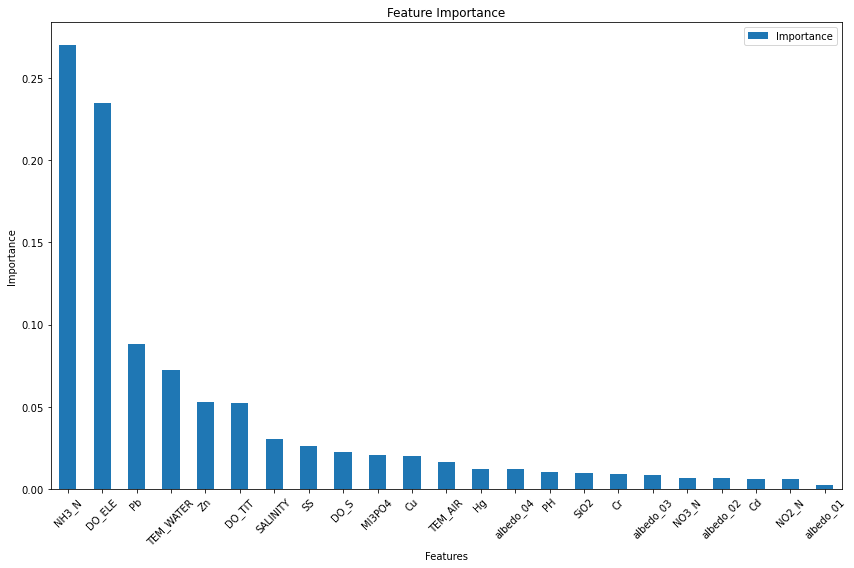

In [167]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error

def convert_value(value):
    if isinstance(value, str):  # check if the value is a string
        if '<' in value:
            return float(value.replace('<', '')) / 2  # divide by 2 as an assumption
        elif value == '--':
            return np.nan  # convert missing data to NaN
        else:
            try:
                return float(value)  # try to convert directly to float
            except ValueError:
                return np.nan  # return NaN for values that can't be converted
    elif np.isnan(value):
        return value  # return NaN if value is already NaN
    else:
        return float(value)  # convert non-string, non-NaN values directly to float


# Load data
file_path = 'D:/temp/merged.csv'  # Replace with your CSV file path
data = pd.read_csv(file_path)

# Apply the convert_value function to the CHL_a column
data['CHL_a'] = data['CHL_a'].apply(convert_value)

# Convert other relevant features that might contain '<' in their values
features = [
    'TEM_AIR', 'TEM_WATER', 'SALINITY', 'PH', 'DO_ELE', 'DO_TIT', 'DO_S', 'SS',
    'NH3_N', 'NO3_N', 'MI3PO4', 'NO2_N', 'SiO2', 'Cd', 'Cr', 'Cu', 'Zn', 'Pb', 'Hg', 'albedo_01', 'albedo_02', 'albedo_03', 'albedo_04'
]
for feature in features:
    data[feature] = data[feature].apply(convert_value)

# Handle NaN values in all features
data.fillna(method='ffill', inplace=True)

# Replace infinity values with NaN and forward-fill again
data.replace([np.inf, -np.inf], np.nan, inplace=True)
data.fillna(method='ffill', inplace=True)

# Ensure that all feature columns are numeric
for feature in features:
    data[feature] = pd.to_numeric(data[feature], errors='coerce')

# Convert 'CHL_a NetCDF (μg/L)' and handle 'none'
data['CHL_a NetCDF (μg/L)'] = pd.to_numeric(data['CHL_a NetCDF (μg/L)'], errors='coerce')

# Creating a mask for rows where 'CHL_a NetCDF (μg/L)' is not NaN (i.e., has a value)
test_mask = ~data['CHL_a NetCDF (μg/L)'].isna()

# Confirm that the test_mask correctly identifies some rows for testing
print(f"Rows for training: {test_mask.sum()}")
print(f"Rows for testing: {(~test_mask).sum()}")

if (~test_mask).sum() > 0:
    X_train = data[test_mask][features]
    y_train = data[test_mask]['CHL_a']
    X_test = data[~test_mask][features]
    y_test = data[~test_mask]['CHL_a']

    # Initialize the XGBoost model
    model = XGBRegressor(objective='reg:squarederror')

    # Train the model
    model.fit(X_train, y_train)

    # Predict on the test set
    y_pred = model.predict(X_test)

    # Evaluate the model
    mse = mean_squared_error(y_test, y_pred)
    print(f"Mean Squared Error (MSE): {mse}")

    # Calculate feature importance and display it
    feature_importance = model.feature_importances_
    importance_df = pd.DataFrame({
        'Feature': features,
        'Importance': feature_importance
    }).sort_values(by='Importance', ascending=False)

    print(importance_df)

    # Plot feature importance
    importance_df.plot(kind='bar', x='Feature', y='Importance', figsize=(12, 8))
    plt.title('Feature Importance')
    plt.ylabel('Importance')
    plt.xlabel('Features')
    plt.xticks(rotation=45)
    plt.tight_layout()  # Adjust layout to prevent clipping of tick-labels
    plt.show()
else:
    print("Insufficient data for testing. Please check your test_mask or provide more data.")

In [168]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"R-squared (R2): {r2}")


Mean Squared Error (MSE): 6.265421597536985
Root Mean Squared Error (RMSE): 2.503082419245716
Mean Absolute Error (MAE): 1.097281461391466
R-squared (R2): 0.08307191854576734


##### NH3_N (氨氮(mg/L))

In [194]:
import pandas as pd
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error

def convert_value(value):
    try:
        if '<' in value:
            return float(value.replace('<', '')) - 0.005
        else:
            return float(value)
    except ValueError:
        return None  # or np.nan, depending on how you want to handle errors

# 加載數據
file_path = 'D:/temp/merged.csv'  # 替換為您的CSV文件路徑
data = pd.read_csv(file_path)

# Apply the convert_value function to NH3_N and CHL_a columns, and any other columns with '<' values
columns_to_convert = ['CHL_a']  # Add all other column names that need conversion
for col in columns_to_convert:
    data[col] = data[col].apply(convert_value)

# Now handle NaN values for all columns
data.fillna(method='ffill', inplace=True)

# Replace infinity values with NaN and forward-fill again
data.replace([np.inf, -np.inf], np.nan, inplace=True)
data.fillna(method='ffill', inplace=True)

# Convert 'CHL_a NetCDF (μg/L)' and other features are numeric
data['CHL_a NetCDF (μg/L)'] = pd.to_numeric(data['CHL_a NetCDF (μg/L)'], errors='coerce')
data['NH3_N'] = pd.to_numeric(data['NH3_N'], errors='coerce')
data['CHL_a'] = pd.to_numeric(data['CHL_a'], errors='coerce')

# Creating a mask for rows where 'CHL_a NetCDF (μg/L)' is not NaN (i.e., has a value)
test_mask = ~data['CHL_a NetCDF (μg/L)'].isna()

# Splitting the dataset into train and test based on the mask
X_train = data[~test_mask][['NH3_N']]
y_train = data[~test_mask]['CHL_a']
X_test = data[test_mask][['NH3_N']]
y_test = data[test_mask]['CHL_a']

# 初始化XGBoost模型
model = XGBRegressor(objective ='reg:squarederror')

# 訓練模型
model.fit(X_train, y_train)

# 預測測試集
y_pred = model.predict(X_test)

# 評估模型
mse = mean_squared_error(y_test, y_pred)
print(f"均方誤差（MSE）: {mse}")


均方誤差（MSE）: 3.8501355593100133


In [195]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"R-squared (R2): {r2}")


Mean Squared Error (MSE): 3.8501355593100133
Root Mean Squared Error (RMSE): 1.9621762304416017
Mean Absolute Error (MAE): 1.1987729181417655
R-squared (R2): -0.00031826268131585067


#### LightGBM

Rows for training: 1155
Rows for testing: 4293
Mean Squared Error (MSE): 4.684177273655971
      Feature  Importance
6        DO_S         582
2    SALINITY         335
7          SS         317
4      DO_ELE         250
0     TEM_AIR         247
16         Zn         193
1   TEM_WATER         191
15         Cu          94
3          PH          91
8       NH3_N          88
19  albedo_01          84
21  albedo_03          80
9       NO3_N          69
17         Pb          65
10     MI3PO4          58
22  albedo_04          57
12       SiO2          50
20  albedo_02          45
18         Hg          31
13         Cd          30
5      DO_TIT          19
14         Cr          12
11      NO2_N          12


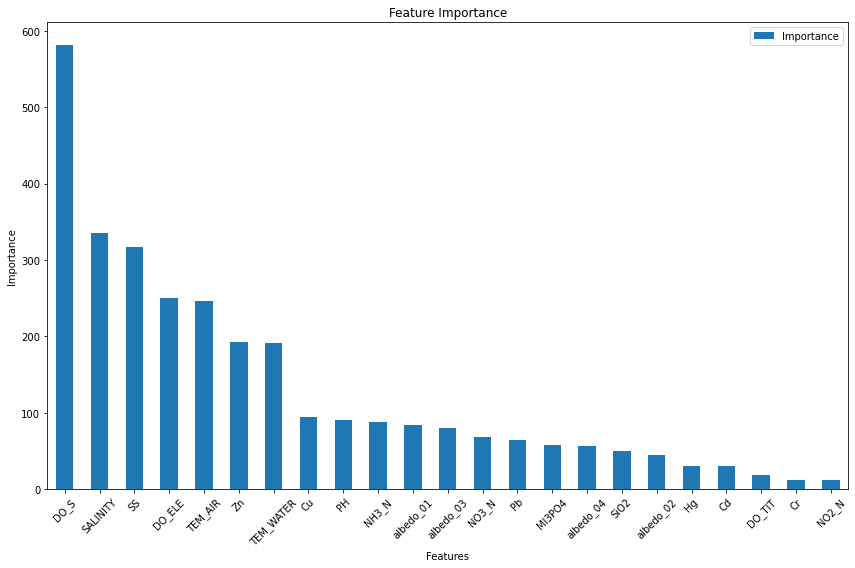

In [184]:
import pandas as pd
import lightgbm as lgb
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

def convert_value(value):
    if isinstance(value, str):  # check if the value is a string
        if '<' in value:
            return float(value.replace('<', '')) / 2  # divide by 2 as an assumption
        elif value == '--':
            return np.nan  # convert missing data to NaN
        else:
            try:
                return float(value)  # try to convert directly to float
            except ValueError:
                return np.nan  # return NaN for values that can't be converted
    elif np.isnan(value):
        return value  # return NaN if value is already NaN
    else:
        return float(value)  # convert non-string, non-NaN values directly to float


# Load data
file_path = 'D:/temp/merged.csv'  # Replace with your CSV file path
data = pd.read_csv(file_path)

# Apply the convert_value function to the CHL_a column
data['CHL_a'] = data['CHL_a'].apply(convert_value)

# Convert other relevant features that might contain '<' in their values
features = [
    'TEM_AIR', 'TEM_WATER', 'SALINITY', 'PH', 'DO_ELE', 'DO_TIT', 'DO_S', 'SS',
    'NH3_N', 'NO3_N', 'MI3PO4', 'NO2_N', 'SiO2', 'Cd', 'Cr', 'Cu', 'Zn', 'Pb', 'Hg', 'albedo_01', 'albedo_02', 'albedo_03', 'albedo_04'
]
for feature in features:
    data[feature] = data[feature].apply(convert_value)

# Handle NaN values in all features
data.fillna(method='ffill', inplace=True)

# Replace infinity values with NaN and forward-fill again
data.replace([np.inf, -np.inf], np.nan, inplace=True)
data.fillna(method='ffill', inplace=True)

# Ensure that all feature columns are numeric
for feature in features:
    data[feature] = pd.to_numeric(data[feature], errors='coerce')

# Convert 'CHL_a NetCDF (μg/L)' and handle 'none'
data['CHL_a NetCDF (μg/L)'] = pd.to_numeric(data['CHL_a NetCDF (μg/L)'], errors='coerce')

# Creating a mask for rows where 'CHL_a NetCDF (μg/L)' is not NaN (i.e., has a value)
test_mask = ~data['CHL_a NetCDF (μg/L)'].isna()

# Confirm that the test_mask correctly identifies some rows for testing
print(f"Rows for training: {test_mask.sum()}")
print(f"Rows for testing: {(~test_mask).sum()}")

if (~test_mask).sum() > 0:
    X_train = data[test_mask][features]
    y_train = data[test_mask]['CHL_a']
    X_test = data[~test_mask][features]
    y_test = data[~test_mask]['CHL_a']

    # Initialize the LightGBM model
    model = lgb.LGBMRegressor(objective='regression')

    # Train the model
    model.fit(X_train, y_train)

    # Predict on the test set
    y_pred = model.predict(X_test)

    # Evaluate the model
    mse = mean_squared_error(y_test, y_pred)
    print(f"Mean Squared Error (MSE): {mse}")

    # Calculate feature importance and display it
    feature_importances = model.feature_importances_
    importance_df = pd.DataFrame({
        'Feature': features,
        'Importance': feature_importances
    }).sort_values(by='Importance', ascending=False)

    print(importance_df)


    # Plot feature importance
    importance_df.plot(kind='bar', x='Feature', y='Importance', figsize=(12, 8))
    plt.title('Feature Importance')
    plt.ylabel('Importance')
    plt.xlabel('Features')
    plt.xticks(rotation=45)
    plt.tight_layout()  # Adjust layout to prevent clipping of tick-labels
    plt.show()
else:
    print("Insufficient data for testing. Please check your test_mask or provide more data.")


In [175]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"R-squared (R2): {r2}")


Mean Squared Error (MSE): 4.684177273655971
Root Mean Squared Error (RMSE): 2.1642960226493906
Mean Absolute Error (MAE): 1.0762569434773828
R-squared (R2): 0.31448289410989894


##### DO_S 溶氧飽和度(%)

In [189]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from lightgbm import LGBMRegressor

def convert_value(value):
    try:
        if '<' in value:
            return float(value.replace('<', '')) - 0.005
        else:
            return float(value)
    except ValueError:
        return None  # or np.nan, depending on how you want to handle errors

# 加载数据
file_path = 'D:/temp/merged.csv'  # 替换为您的CSV文件路径
data = pd.read_csv(file_path)

# Apply the convert_value function
data['CHL_a'] = data['CHL_a'].apply(convert_value)

# Convert 'CHL_a NetCDF (μg/L)' and handle 'none'
data['CHL_a NetCDF (μg/L)'] = pd.to_numeric(data['CHL_a NetCDF (μg/L)'], errors='coerce')

# Creating a mask for rows where 'CHL_a NetCDF (μg/L)' is not NaN (i.e., has a value)
test_mask = ~data['CHL_a NetCDF (μg/L)'].isna()

# Splitting the dataset into train and test based on the mask
X_train = data[~test_mask][['DO_S']]
y_train = data[~test_mask]['CHL_a']
X_test = data[test_mask][['DO_S']]
y_test = data[test_mask]['CHL_a']

# 初始化LightGBM模型
model = LGBMRegressor()

# 训练模型
model.fit(X_train, y_train)

# 预测测试集
y_pred = model.predict(X_test)

# 评估模型
mse = mean_squared_error(y_test, y_pred)
print(f"均方误差（MSE）: {mse}")


均方误差（MSE）: 3.154399150925437


In [188]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"R-squared (R2): {r2}")

Mean Squared Error (MSE): 3.2159458651992923
Root Mean Squared Error (RMSE): 1.7933058482030588
Mean Absolute Error (MAE): 1.1070164528819955
R-squared (R2): 0.16445295725383924


### 儲存模型

In [ ]:
from joblib import dump, load

# Save the model
dump(model, 'xgb_model.joblib')

# Load the model (when needed)
model = load('xgb_model.joblib')

# (五) 評估

# (六) 氣象局衛星資料

### 資料解析

##### 資料1

In [ ]:
import leafmap.foliumap as leafmap
filename = 'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/jma/netcdf/2016/01/NC_H08_20160104_1120_R21_FLDK.02401_02401.nc'
filename2 =  'G:/My Drive/DIC Desktop/3 grade s1/thesis/PTree dataset/pub/himawari/min/CHL/H08_20160104_1100_1H_ROC021_FLDK.02401_02401.nc'

data = leafmap.read_netcdf(filename) #H08_20220317_0000_1D_ROC021_FLDK.02401_02401.nc
data

<xarray.Dataset>
Dimensions:              (band: 16, geometry: 17, latitude: 2401, longitude: 2401, time: 1)
Coordinates:
  * latitude             (latitude) float32 60.0 59.95 59.9 ... -59.95 -60.0
  * longitude            (longitude) float32 80.0 80.05 80.1 ... 200.0 200.0
Dimensions without coordinates: band, geometry, time
Data variables: (12/26)
    band_id              (band) int32 ...
    start_time           (time) datetime64[ns] ...
    end_time             (time) datetime64[ns] ...
    geometry_parameters  (geometry) float64 ...
    albedo_01            (latitude, longitude) float32 ...
    albedo_02            (latitude, longitude) float32 ...
    ...                   ...
    tbb_16               (latitude, longitude) float32 ...
    SAZ                  (latitude, longitude) float32 ...
    SAA                  (latitude, longitude) float32 ...
    SOZ                  (latitude, longitude) float32 ...
    SOA                  (latitude, longitude) float32 ...
    Hour                 (latitude, longitude) timedelta64[ns] ...
Attributes:
    title:                 Himawari-8 AHI equal latitude-longitude map data
    id:                    NC_H08_20160104_1120_R21_FLDK.02401_02401.nc
    date_created:          2016-09-10T01:35:51Z
    pixel_number:          2401
    line_number:           2401
    upper_left_latitude:   60.0
    upper_left_longitude:  80.0
    grid_interval:         0.05
    band_number:           16

##### 資料2

In [52]:
import numpy as np

def read_binary_file(file_path):
    try:
        # 使用適當的數據類型
        data_type = np.float32  # 假設數據是32位浮點數

        # 由於我們不確定具體的形狀，先將其讀取為一維數組
        data = np.fromfile(file_path, dtype=data_type)

        return data
    except FileNotFoundError:
        return "File not found."
    except Exception as e:
        return f"An error occurred: {e}"

# 替换为你的文件路径
file_path = 'D:/temp/NAMR/2016-01-04_0000.namr.B01.Gray.6600.bin'
data = read_binary_file(file_path)
print("Data shape:", data.shape)

Data shape: (43560000,)


In [61]:
import numpy as np
import os

# 文件路径
file_path = 'D:/temp/NAMR/2016-01-04_0000.namr.B01.Gray.6600.bin'

# 读取文件
with open(file_path, 'rb') as file:
    data_latlon = np.fromfile(file, dtype='float32')

# 确定每个部分的大小
file_size = os.path.getsize(file_path)
print(f"文件大小：{file_size} 字节")

# 计算每部分的大小
part_size = 6600 * 6600 * 4  # float32 类型每个元素 4 字节

if file_size >= 2 * part_size:
    # 读取文件
    with open(file_path, 'rb') as file:
        data_latlon = np.fromfile(file, dtype='float32')

    # 提取纬度和经度数据，并重塑
    lat = data_latlon[:part_size // 4].reshape(6600, 6600)
    lon = data_latlon[part_size // 4:2 * (part_size // 4)].reshape(6600, 6600)

# 对数据进行进一步处理...


文件大小：174240000 字节


In [67]:
import numpy as np
#800x800:
file_latlon=open('D:/temp/NAMR/2016-01-04_0000.namr.B01.Gray.6600.bin','rb')
data = np.fromfile(file_latlon,dtype='float32')

data=data[0:174240000]
data=data.reshape(6600,6600)

data
# lon=data_latlon[174240000:348480000]
# lon=lon.reshape(6600,6600)

array([[ 1.2352941,  1.2352941,  1.2941177, ..., 23.058823 , 23.411764 ,
        23.411764 ],
       [ 1.2352941,  1.2352941,  1.2941177, ..., 23.058823 , 23.411764 ,
        23.411764 ],
       [ 1.2352941,  1.2352941,  1.2352941, ..., 23.058823 , 23.411764 ,
        23.411764 ],
       ...,
       [ 8.117647 ,  7.4117646,  7.4117646, ...,  8.941176 ,  8.941176 ,
         9.411765 ],
       [ 7.470588 ,  7.1764708,  7.1764708, ...,  8.941176 ,  8.941176 ,
         9.411765 ],
       [ 7.470588 ,  7.470588 ,  7.1764708, ...,  7.8235292,  7.8235292,
         9.3529415]], dtype=float32)

# (七) SR資料解析

In [7]:
!pip3 install numpy
!pip3 install xarray

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 1.5 MB/s eta 0:00:0000:0100:010m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.6/12.6 MB 2.4 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 505.5/505.5 kB 2.8 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 345.4/345.4 kB 3.6 MB/s eta 0:00:0000:0100:01


In [8]:
import numpy as np
import xarray as xr
import warnings
warnings.filterwarnings("ignore", message=".*Passing method to Float64Index.get_loc is deprecated.*")

year = 2023
month = '09'
date = '12'
hour = '10'
min = '00'

filename = f'./NC_H09_{year}{month}{date}_{hour}{min}_R21_FLDK.06001_06001.nc'
ds = xr.open_dataset(filename)

delta_dict = {}

for lat in np.arange(21, 27, 0.001):
    prev_lon = 0
    lon_delta_list = []
    for lon in np.arange(117, 123, 0.001):
        albedo_01_value = ds['albedo_01'].sel(longitude=lon, latitude=lat, method='nearest').values
        albedo_02_value = ds['albedo_02'].sel(longitude=lon, latitude=lat, method='nearest').values
        albedo_03_value = ds['albedo_03'].sel(longitude=lon, latitude=lat, method='nearest').values
        albedo_04_value = ds['albedo_04'].sel(longitude=lon, latitude=lat, method='nearest').values

        cur_val = (albedo_01_value, albedo_02_value, albedo_03_value, albedo_04_value)
        if lon > 117 and cur_val != prev_val:
            lon_delta = lon - prev_lon
            lon_delta_list.append(lon_delta)
            prev_lon = lon

        prev_val = cur_val

    delta_dict[lat] = lon_delta_list

# 將字典轉換為二維陣列
delta_arr = [delta_dict[lat] for lat in sorted(delta_dict)]

print(delta_arr)


ValueError: found the following matches with the input file in xarray's IO backends: ['netcdf4', 'h5netcdf']. But their dependencies may not be installed, see:
https://docs.xarray.dev/en/stable/user-guide/io.html 
https://docs.xarray.dev/en/stable/getting-started-guide/installing.html

In [17]:
import numpy as np
import warnings
warnings.filterwarnings("ignore", message=".*Passing method to Float64Index.get_loc is deprecated.*")

year = 2023
month = '09'
date = '11'
hour = '09'
min = '10'

filename = 'D:/dataset/2km/{year}/{month}/NC_H09_{year}{month}{date}_{hour}{min}_R21_FLDK.06001_06001.nc'.format(year=year, month=month, date=date, hour=hour, min=min)
ds = xr.open_dataset(filename)

lon = 120
cur_val1 = 0
cur_val2 = 0
cur_val3 = 0
cur_val4 = 0
prev_lat = 0
lat_delta = 0
delta_arr = []
for lat in np.arange(23, 24, 0.001):
    albedo_01_value = ds['albedo_01'].sel(longitude=lon, latitude=lat, method='nearest').values
    albedo_02_value = ds['albedo_02'].sel(longitude=lon, latitude=lat, method='nearest').values
    albedo_03_value = ds['albedo_03'].sel(longitude=lon, latitude=lat, method='nearest').values
    albedo_04_value = ds['albedo_04'].sel(longitude=lon, latitude=lat, method='nearest').values
    if cur_val1 != albedo_01_value or cur_val2 != albedo_02_value or cur_val3 != albedo_03_value or cur_val4 != albedo_04_value:
        cur_val1 = albedo_01_value
        cur_val2 = albedo_02_value
        cur_val3 = albedo_03_value
        cur_val4 = albedo_04_value
        lat_delta = lat - prev_lat
        delta_arr.append(lat_delta)
        prev_lat = lat
    print("(",lat,"," ,lon,")")
    print(albedo_01_value)    
print(delta_arr)

( 23.0 , 120 )
0.2066
( 23.001 , 120 )
0.2066
( 23.002000000000002 , 120 )
0.2066
( 23.003000000000004 , 120 )
0.2066
( 23.004000000000005 , 120 )
0.2066
( 23.005000000000006 , 120 )
0.2066
( 23.006000000000007 , 120 )
0.2066
( 23.00700000000001 , 120 )
0.2066
( 23.00800000000001 , 120 )
0.2066
( 23.00900000000001 , 120 )
0.2066
( 23.010000000000012 , 120 )
0.1917
( 23.011000000000013 , 120 )
0.1917
( 23.012000000000015 , 120 )
0.1917
( 23.013000000000016 , 120 )
0.1917
( 23.014000000000017 , 120 )
0.1917
( 23.01500000000002 , 120 )
0.1917
( 23.01600000000002 , 120 )
0.1917
( 23.01700000000002 , 120 )
0.1917
( 23.018000000000022 , 120 )
0.1917
( 23.019000000000023 , 120 )
0.1917
( 23.020000000000024 , 120 )
0.1917
( 23.021000000000026 , 120 )
0.1917
( 23.022000000000027 , 120 )
0.1917
( 23.023000000000028 , 120 )
0.1917
( 23.02400000000003 , 120 )
0.1917
( 23.02500000000003 , 120 )
0.1917
( 23.02600000000003 , 120 )
0.1917
( 23.027000000000033 , 120 )
0.1917
( 23.028000000000034 , 120 

In [591]:
# Open the NetCDF file using xarray
data = xr.open_dataset(filename)

# Extract the "units" attribute for a specific variable (e.g., 'albedo_01')
units = data['albedo_01'].attrs['units']
albedo_01_data = data['albedo_01']

# Print the units
print("Units:", units)

# Print the data
print(albedo_01_data)

Units: 1
<xarray.DataArray 'albedo_01' (latitude: 2401, longitude: 2401)>
[5764801 values with dtype=float32]
Coordinates:
  * latitude   (latitude) float32 60.0 59.95 59.9 59.85 ... -59.9 -59.95 -60.0
  * longitude  (longitude) float32 80.0 80.05 80.1 80.15 ... 199.9 200.0 200.0
Attributes:
    long_name:  reflectance*cos(SOZ) of band 01
    units:      1
    valid_min:  0
    valid_max:  31400
